# Assignment 2 : AER 1515
Tushar Aggarwal Python Code:

### Outline:

* Provided Code
* Feature Detector Function
* Feature Matching Function
* Outlier, Depth adn Disparity Calculation Function
* Training Image code (file location and Main Body)
* Test Image Code (file Location and Main Body)
* Some RMSE values from Hyperparameter Tuning

<br>
If you have ground Truth Images for Test Images. On Line 6 set variable mode = "Training". This will show RMSE score as well.


In [1]:
try:
    import numpy as np
except:
    !pip install numpy
    import numpy as np
try:
    import cv2 as cv
except:
    !pip install opencv-python
    import cv2 as cv

from matplotlib import pyplot as plt
import matplotlib.image as mpimg
import csv
import os

In [2]:
class FrameCalib:
    """Frame Calibration

    Fields:
        p0-p3: (3, 4) Camera P matrices. Contains extrinsic and intrinsic parameters.
        r0_rect: (3, 3) Rectification matrix
        velo_to_cam: (3, 4) Transformation matrix from velodyne to cam coordinate
            Point_Camera = P_cam * R0_rect * Tr_velo_to_cam * Point_Velodyne
        """

    def __init__(self):
        self.p0 = []
        self.p1 = []
        self.p2 = []
        self.p3 = []
        self.r0_rect = []
        self.velo_to_cam = []

In [3]:
class StereoCalib:
    """Stereo Calibration

    Fields:
        baseline: distance between the two camera centers
        f: focal length
        k: (3, 3) intrinsic calibration matrix
        p: (3, 4) camera projection matrix
        center_u: camera origin u coordinate
        center_v: camera origin v coordinate
        """

    def __init__(self):
        self.baseline = 0.0
        self.f = 0.0
        self.k = []
        self.center_u = 0.0
        self.center_v = 0.0

In [4]:
def read_frame_calib(calib_file_path):
    """Reads the calibration file for a sample

    Args:
        calib_file_path: calibration file path

    Returns:
        frame_calib: FrameCalib frame calibration
    """

    data_file = open(calib_file_path, 'r')
    data_reader = csv.reader(data_file, delimiter=' ')
    data = []

    for row in data_reader:
        data.append(row)

    data_file.close()

    p_all = []

    for i in range(4):
        p = data[i]
        p = p[1:]
        p = [float(p[i]) for i in range(len(p))]
        p = np.reshape(p, (3, 4))
        p_all.append(p)

    frame_calib = FrameCalib()
    frame_calib.p0 = p_all[0]
    frame_calib.p1 = p_all[1]
    frame_calib.p2 = p_all[2]
    frame_calib.p3 = p_all[3]

    # Read in rectification matrix
    tr_rect = data[4]
    tr_rect = tr_rect[1:]
    tr_rect = [float(tr_rect[i]) for i in range(len(tr_rect))]
    frame_calib.r0_rect = np.reshape(tr_rect, (3, 3))

    # Read in velodyne to cam matrix
    tr_v2c = data[5]
    tr_v2c = tr_v2c[1:]
    tr_v2c = [float(tr_v2c[i]) for i in range(len(tr_v2c))]
    frame_calib.velo_to_cam = np.reshape(tr_v2c, (3, 4))

    return frame_calib

In [5]:
def krt_from_p(p, fsign=1):
    """Factorize the projection matrix P as P=K*[R;t]
    and enforce the sign of the focal length to be fsign.


    Keyword Arguments:
    ------------------
    p : 3x4 list
        Camera Matrix.

    fsign : int
            Sign of the focal length.


    Returns:
    --------
    k : 3x3 list
        Intrinsic calibration matrix.

    r : 3x3 list
        Extrinsic rotation matrix.

    t : 1x3 list
        Extrinsic translation.
    """
    s = p[0:3, 3]
    q = np.linalg.inv(p[0:3, 0:3])
    u, b = np.linalg.qr(q)
    sgn = np.sign(b[2, 2])
    b = b * sgn
    s = s * sgn

    # If the focal length has wrong sign, change it
    # and change rotation matrix accordingly.
    if fsign * b[0, 0] < 0:
        e = [[-1, 0, 0], [0, 1, 0], [0, 0, 1]]
        b = np.matmul(e, b)
        u = np.matmul(u, e)

    if fsign * b[2, 2] < 0:
        e = [[1, 0, 0], [0, -1, 0], [0, 0, 1]]
        b = np.matmul(e, b)
        u = np.matmul(u, e)

    # If u is not a rotation matrix, fix it by flipping the sign.
    if np.linalg.det(u) < 0:
        u = -u
        s = -s

    r = np.matrix.transpose(u)
    t = np.matmul(b, s)
    k = np.linalg.inv(b)
    k = k / k[2, 2]

    # Sanity checks to ensure factorization is correct
    if np.linalg.det(r) < 0:
        print('Warning: R is not a rotation matrix.')

    if k[2, 2] < 0:
        print('Warning: K has a wrong sign.')

    return k, r, t


In [6]:
def get_stereo_calibration(left_cam_mat, right_cam_mat):
    
    """Extract parameters required to transform disparity image to 3D point
    cloud.

    Keyword Arguments:
    ------------------
    left_cam_mat : 3x4 list
                   Left Camera Matrix.

    right_cam_mat : 3x4 list
                   Right Camera Matrix.


    Returns:
    --------
    stereo_calibration_info : Instance of StereoCalibrationData class
                              Placeholder for stereo calibration parameters.
    """

    stereo_calib = StereoCalib()
    k_left, r_left, t_left = krt_from_p(left_cam_mat)
    _, _, t_right = krt_from_p(right_cam_mat)

    stereo_calib.baseline = abs(t_left[0] - t_right[0])
    stereo_calib.f = k_left[0, 0]
    stereo_calib.k = k_left
    stereo_calib.center_u = k_left[0, 2]
    stereo_calib.center_v = k_left[1, 2]

    return stereo_calib

**Solutions for Part 1, 2 and 3 are implemented using functions to avoid repeatability**

# Feature Detector Function

This Function is used to detect features. There are currently 3 detectors with SIFT being the default one and default 1000 features.
User has the ability to specify the following functions:
<li> SIFT
<li> FAST
<li> ORB
<br>
**Note this fucntion may seem too long, however, it was implemented to test different agorithms and fr future implementations**

In [72]:
def feature_detection(img, side, img_show="yes", detector= 'sift', num =1000):
    '''
    img  = Image File Passed Throught The Function
    
    side  = Description ('String Value') about the image (left or right)
    
    img_show="yes"  = An argument to display image or not. Default is Yes (We send no for right image)
    
    detector= 'sift'  = Specify the detector to be used options are: (Note: size to display larger feature point)
                                                                    fast, 
                                                                    fast_without_nonmax, 
                                                                    sift, 
                                                                    sift_size, 
                                                                    orb
                                                                    orb_size
                                                                
    num =1000 = # of max features to be  selected
    '''
    
    
    # Converting image to RGB
    img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)

    # Convert image to gray scale
    gray = cv.cvtColor(img_rgb, cv.COLOR_RGB2GRAY)
    
    # Detecting Keypoints on Image
    
    if detector == 'fast':

        # Initiate FAST object with default values
        fast = cv.FastFeatureDetector_create(nfeatures=num)  

        # Detect keypoints
       
        kp = fast.detect(gray, None)
        
        # Print all default params
        print( "Threshold: {}".format(fast.getThreshold()) )
        print( "nonmaxSuppression:{}".format(fast.getNonmaxSuppression()) )
        print( "neighborhood: {}".format(fast.getType()) )
        print( "Total Keypoints with nonmaxSuppression: {}".format(len(kp)) )
        
        # Making a copy of the image
        image_with_nonmax = np.copy(img_rgb)
        
        # Drawing keypoints
        img_kp = cv.drawKeypoints(img_rgb, kp, image_with_nonmax, color=(0,255,0), flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        
        # Display image with non max suppression
        title_img = "FAST detector image With Non Max Suppression"
        
        print("Total Keypoints Detected (With Non Max Suppression): ", len(kp))
    
    elif detector == 'fast_without_nonmax':
        
        # Initiate FAST object with default values
        fast = cv.FastFeatureDetector_create(nfeatures=num)  
        
        # Disable nonmaxSuppression and  Detect & Draw keypoints on the image
        fast.setNonmaxSuppression(False)
        
        #Detect keypoints
        kp = fast.detect(gray, None)
             
        # Making a copy of the image
        image_without_nonmax = np.copy(img_rgb)

        # Drawing keypoints
        img_kp = cv.drawKeypoints(img_rgb, kp, image_without_nonmax, color=(0,255,0), flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

        # Display image without non max suppression       

        #ax[1,1].set_title("Without non max suppression")
        #ax[1,1].imshow(image_without_nonmax)
        
        title_img = "FAST detector image Without Non Max Suppression"

        # Print the number of keypoints detected in the query image
        print("Total Keypoints Detected (Without Non Max Suppression): ", len(kp))

        
    elif detector == 'sift_size':
                
        sift = cv.SIFT_create(nfeatures=num)
        
        #Detect & Draw keypoints on the image
        kp, des = sift.detectAndCompute(gray,None)
        
        img_with_size = np.copy(img_rgb)
        
        # Display Key Points
        img_kp = cv.drawKeypoints(img_rgb, kp ,img_with_size,flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        
        title_img = "SIFT detector Image keypoints (large size)"
        
        #ax[1,0].set_title("Image with size of keypoints")
        #ax[1,0].imshow(img_with_size)
        
        # Print the number of keypoints detected 
        print("Number of Keypoints Detected: ", len(kp))

        
    elif detector == 'sift':
        
        sift = cv.SIFT_create(nfeatures=num)
        
        #Detect & Draw keypoints on the image
        kp, des = sift.detectAndCompute(gray,None)
        
        img_no_size = np.copy(img_rgb)
        
        # Display Key Points
        img_kp = cv.drawKeypoints(img_rgb, kp ,img_no_size)
        
        # Display Image with Keypoints
        #ax[1,0].set_title("Image with without of keypoints")
        #ax[1,0].imshow(img_without_size)
        
        title_img = "SIFT detector Image keypoints (small size)"
        

        # Print the number of keypoints detected 
        print("Number of Keypoints Detected: ", len(kp))

  
    elif detector == 'orb':
       
        # Initiate ORB detector
        orb = cv.ORB_create(nfeatures=num)
        
        # find the keypoints with ORB
        #kp = orb.detect(gray,None)
        
        # Detect and Compute the descriptors with ORB
        kp, des = orb.detectAndCompute(gray, None)
        
        # Make a copy of the Image
        img1 = np.copy(img_rgb)

        
        # draw only keypoints location,not size and orientation
        img_kp = cv.drawKeypoints(img_rgb, kp, img1, color=(0,255,0), flags=0)
        title_img = "Orb detector Image keypoints (small size)"
        
        # Print the number of keypoints detected 
        print("Number of Keypoints Detected: ", len(kp))
    
    elif detector == 'orb_size':
       
        # Initiate ORB detector
        orb = cv.ORB_create(nfeatures=num)
        
        # find the keypoints with ORB
        #kp = orb.detect(gray,None)
        
        # compute the descriptors with ORB
        kp, des = orb.detectAndCompute(gray, None)
        
        # draw only keypoints location,not size and orientation
        img1 = np.copy(img_rgb)
        
        img_kp = cv.drawKeypoints(img_rgb, kp, img1, color=(0,255,0), flags = cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        
        title_img = "Orb Image with size keypoints"
        
        # Print the number of keypoints detected 
        print("Number of Keypoints Detected: ", len(kp))
        
    
    # Plotting images to visualize only if the user asked for it
    if img_show == "yes":
        fx, ax = plt.subplots(1, 2, figsize=(20,10))

        ax[0].set_title("Orignal "+side)
        ax[0].imshow(img_rgb)

        #ax[0,0].imshow(img_rgb)
        #ax[0,0].set_title("Orignal Image")
        #ax[0,0].imshow(img_rgb)

        #ax[0,1].set_title("Gray Image")
        #ax[0,1].imshow(gray, cmap="gray")
        #ax[0,1].set_title(side+": "+title_img)
        #ax[0,1].imshow(img_kp)

        ax[1].set_title(side+": "+title_img)
        ax[1].imshow(img_kp)

        plt.show()
    else:
        print("\nVisualization turned off")
    
    return kp, des, img_rgb, gray
        
    
    

# Feature Matching

In [157]:
def feature_matching(left_kp, left_des, img_left, img_left_gray, right_kp, right_des, img_right_rgb, img_right_gray):
    
    ''' This Function is for Feature Matching and we will be using Brute Force
    it returns matched features along with matches after epipolar constraints
    Arguments:
    left_kp, = Left Image Keypoints
    left_des, = Left Image Descriptors
    img_left, = Left RGB Image
    img_left_gray, = Left Grayscale Image
    
    right_kp, = Right Image Keypoints
    right_des, = Right Image Descriptors
    img_right_rgb, = Right RGB Image
    img_right_gray = Right Grayscale Image
    
    '''
    
    # We will use a brute force matcher
    bf = cv.BFMatcher(cv.NORM_L2, crossCheck = True)
    
    # Perform the matching between the descriptors of the training image and the test image
    matches = bf.match(left_des, right_des)

        

    # Sort them in the order of their distance.
    matches = sorted(matches, key = lambda x : x.distance)
    
    
    img_match = cv.drawMatches(img_left_rgb, left_kp, 
                               img_right_rgb, right_kp, 
                               matches, None, 
                               flags = cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    # Display the best matching points
    plt.rcParams['figure.figsize'] = [15, 8]
    plt.title('Matching Best Points in Left and Right Images')
    plt.imshow(img_match)
    plt.show()
    
    # Print total number of matching points between the training and query images
    print("Total Matching Points Between Left and Right Image: ", len(matches))
       
    print("\t"*6,"-"*25)
    
    
    print("\n Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1")
    
    good = []
    
    for match in matches:
        x_left, y_left = left_kp[match.queryIdx].pt
        x_right, y_right = right_kp[match.trainIdx].pt
        if abs(y_left - y_right) <= 1:    
            good.append(match)
            
    
    img_good = cv.drawMatches(img_left_rgb, left_kp, 
                         img_right_rgb, right_kp,
                          good, None,
                          flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
   
    plt.figure()
    plt.imshow(img_good)
    plt.title('Matching Points in Left and Right Images after applying a Constraint on Y axis')
    plt.show()
    
    print('Total features after applying constraint on y-axis of keypoint: {}'.format(len(good)))
    
    
    # Returning regular Brute Force Matching Along with 
    # good Matching points with difference in y<1 between the 2 images

    return matches, good 



# Outlier Detection and Feature Depth Calculations

In [158]:
def feature_outlier(matches, kp_left, kp_right,frame_calib_path, img_left_rgb, img_right_rgb, depth_image,mode, ransac = True):
    '''
    This Functions Performs Outlier Rejection, Calculates Disparity and Depth
    
    Arguments:
    
        matches  = Matches obtained from feature_matching (without epipolar constraints)

        kp_left = Left Image Keypoints
        kp_right = Right Image Keypoints

        frame_calib_path = path to Frame Caliberation file

        img_left_rgb = Left RGB Image
        img_right_rgb = Right RGB Image

        depth_image = Depth Ground Truth Image

        mode = 'Training' mode or 'Test' mode
        ransac = True (to apply RANSAC Outlier Rejection or should we skip)
    '''
    
    # Get Frame Caliberation
    frame_calib = read_frame_calib(frame_calib_path)
    
    # Get Stereo Camera Caliberation
    stereo_calib = get_stereo_calibration(frame_calib.p2, frame_calib.p3)
    
    # Extract Baseline and focus information
    baseline = stereo_calib.baseline
    f = stereo_calib.f
    focus_base = baseline*f
    
    
    # Declare required Arrays/List
    ul = stereo_calib.center_u # Center u value for left camera
    vl = stereo_calib.center_v # Center v value for left camera
    xl_list = []
    yl_list = []
    
    X = []
    Y = []
    RMSE_list = []
    #initialize arrays for left and right image matrix
    left_points = []
    pixel_u_l_list = [] # x pixel on left image
    pixel_v_l_list = [] # y pixel on left image
    
    right_points = []
    pixel_u_r_list = [] # x pixel on right image
    pixel_v_r_list = [] # y pixel on right image
    
    # initializing array for disparity and depth calculation points
    disparity_list = []
    depth_list = []
    
    # Ground truth depth pixel
    img_depth_Pixel = []
    
    # IF OUTLIER REJECTION IS SET TO TRUE
    if ransac:
        src_pts = np.float32([ kp_left[match.queryIdx].pt for match in matches ]).reshape(-1,1,2)
        dst_pts = np.float32([ kp_right[match.trainIdx].pt for match in matches]).reshape(-1,1,2)
        
        #M, mask = cv.findHomography(src_pts, dst_pts, cv.RANSAC,
        #                            ransacReprojThreshold = 0.1, maxIters=3000, confidence = 0.99)
        
        
        #Applying RANSAC using findFundamentalAMT function 
        M, mask =cv.findFundamentalMat(src_pts, dst_pts, cv.FM_RANSAC, 0.5,0.99)
        
        matchesMask = mask.ravel().tolist()
        
        #print(matchesMask)
        #print("")
        inlier_indices = np.nonzero(matchesMask)[0]
        
        
        draw_params = dict(singlePointColor = None,
                   matchesMask = matchesMask, # draw only inliers
                   flags = 2)
        
        
        
        ransac_matches = cv.drawMatches(img_left_rgb, kp_left, img_right_rgb, kp_right,matches,None,**draw_params)
        plt.figure(figsize=(16, 16))
        plt.title('Matches Found After Implementing RANSAC Outlier rejection')
        plt.imshow(ransac_matches)
        plt.show()

        # ONLY LOOKING AT MATCHES WHERE RANSAX RETURNED 1 (NOT AN OUTLIER)
        for match in [matches[i] for i in inlier_indices]:
        
        #for match in matches: # THIS LINE IS TO BE IGNORED
        
            (x1, y1) = kp_left[match.queryIdx].pt
            (x2, y2) = kp_right[match.trainIdx].pt

            # Left Points Calculations
            left_points.append((x1, y1))     
            pixel_u_l_list.append(int(x1))
            pixel_v_l_list.append(y1)

            # Right Points Calculations
            right_points.append((x2, y2))
            pixel_u_r_list.append(x2)
            pixel_v_r_list.append(y2)
            
            if x1 != x2:
                disparity = abs(x1 - x2)
                disparity_list.append(int(disparity))

                #print(x1," - ",x2," = ",disparity)

                # Calculating Depth
                depth = focus_base/disparity
                depth_list.append(depth)

                xl = abs(x1 - ul)
                xl_list.append(xl)
                X.append((depth*xl)/f)

                yl = abs(y1 - vl)
                yl_list.append(yl)
                Y.append((depth*yl)/f)

                if mode == "Training":
                
                    try:
                        img_depth_Pixel.append(depth_image[int(x1),int(y1)])
                        
                        # Check if the pixel value on the depth image is 0 or not
                        if depth_image[int(x1),int(y1)] !=0:
                            RMSE_list.append(depth - (depth_image[int(x1),int(y1)]))
                        
                        check = True
                    except:
                        check = False

                    #print("image gt depth: :",img_depth_Pixel," Calculated depth: ", depth)
        
        if mode == "Training":
            if check:
                RMSE_SCORE = np.array(RMSE_list)


                RMSE = np.sqrt(np.mean(np.power(RMSE_SCORE, 2)))
                #print("RMSE: ",RMSE)
            else:
                RMSE = 'N/A'
        else:
            RMSE = 'N/A'
        
        matches_non_zero = [matches[i] for i in inlier_indices]
        print('Total features after applying RANSAC outlier rejections: {}'.format(len(matches_non_zero)))
    else:
        pass
    
   
    
    return  left_points, right_points, pixel_u_l_list, pixel_v_l_list, disparity_list, depth_list, X, Y, RMSE, matches_non_zero

        

# Working on Training Data
## File Location  - Training

In [151]:
## Input
left_image_dir = os.path.abspath('.\\training\\left')
#print('Left Image Directory: ',left_image_dir)

right_image_dir = os.path.abspath('.\\training\\right')
#print('Right Image Directory: ',right_image_dir)

calib_dir = os.path.abspath('.\\training\\calib')
#print('Calib Directory: ',calib_dir)

try:
    gt_depth = os.path.abspath('.\\training\\gt_depth_map')
except:
    pass

sample_list = ['000001', '000002', '000003', '000004','000005', '000006', '000007', '000008', '000009', '000010']



## Main Function - Training

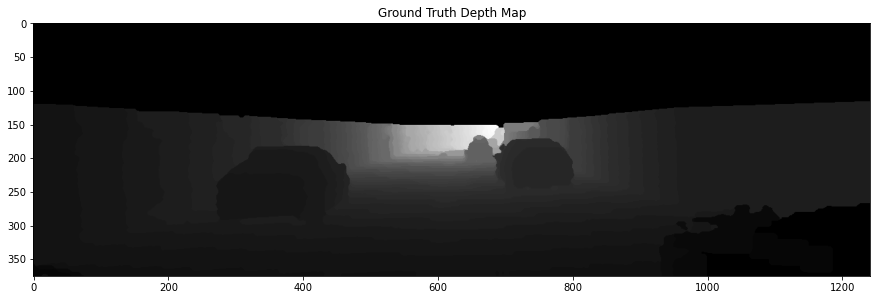


 ------------------------------------------------------ Part1 - Image: 1 ------------------------------------------------------
Left Image 1
Number of Keypoints Detected:  1000


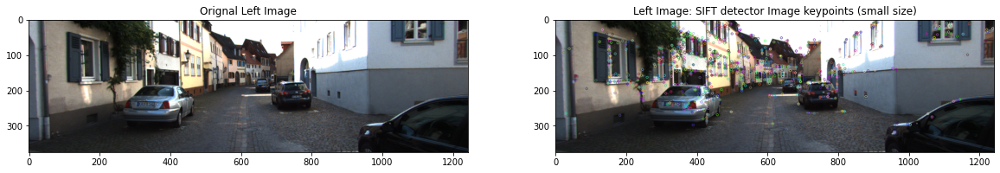

Right Image 1
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 1 ------------------------------------------------------


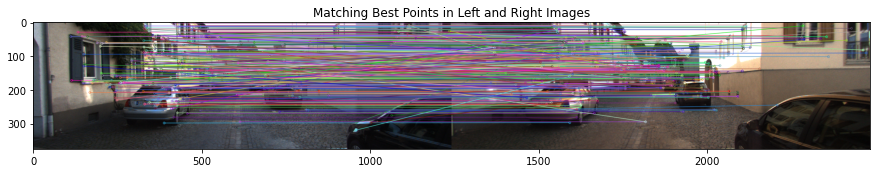

Total Matching Points Between Left and Right Image:  558
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


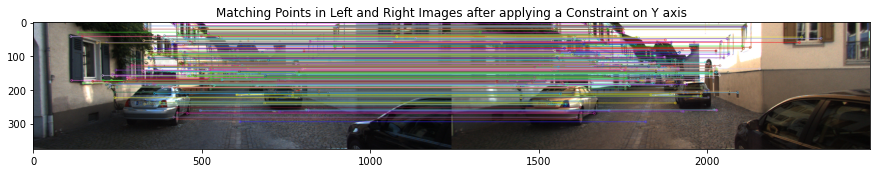

Total features after applying constraint on y-axis of keypoint: 438

 ------------------------------------------------------ Part3 - Image: 1 ------------------------------------------------------


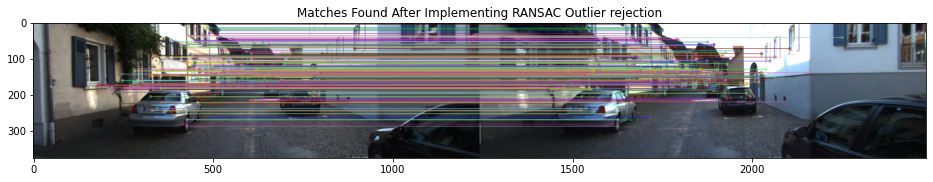


RMSE:  4.39638137730313


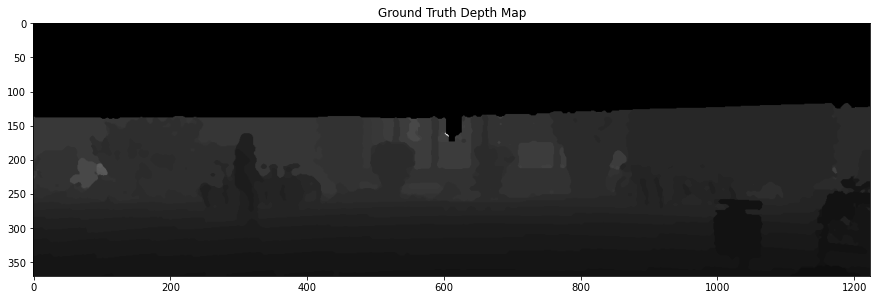


 ------------------------------------------------------ Part1 - Image: 2 ------------------------------------------------------
Left Image 2
Number of Keypoints Detected:  1000


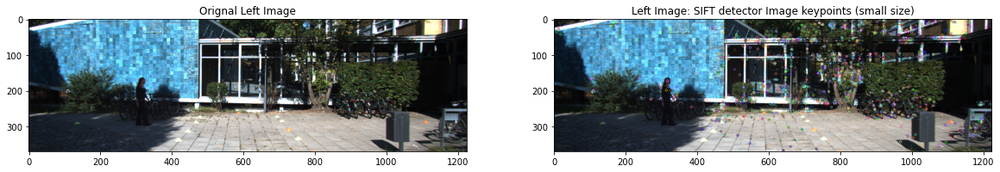

Right Image 2
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 2 ------------------------------------------------------


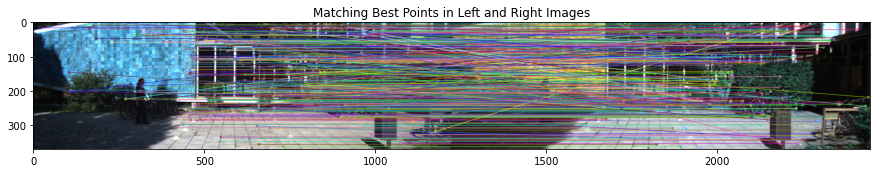

Total Matching Points Between Left and Right Image:  457
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


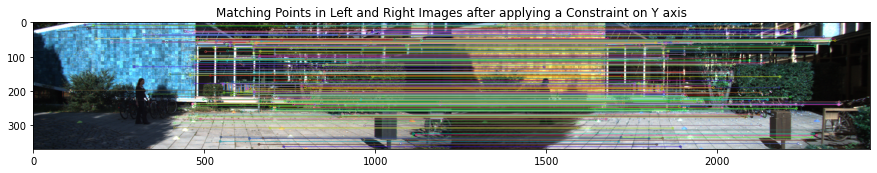

Total features after applying constraint on y-axis of keypoint: 318

 ------------------------------------------------------ Part3 - Image: 2 ------------------------------------------------------


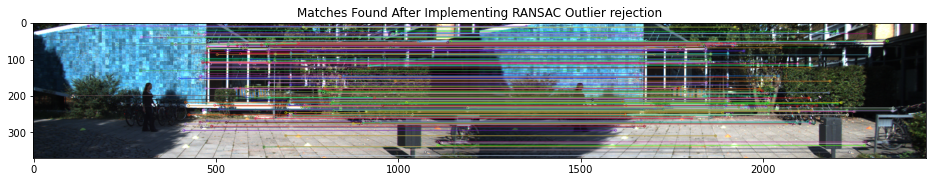


RMSE:  0.9321201302288871


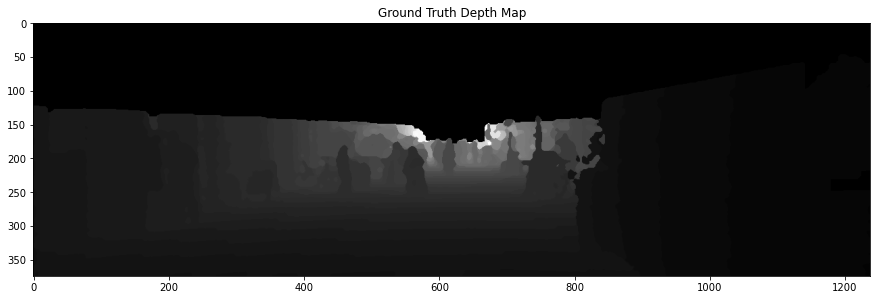


 ------------------------------------------------------ Part1 - Image: 3 ------------------------------------------------------
Left Image 3
Number of Keypoints Detected:  1000


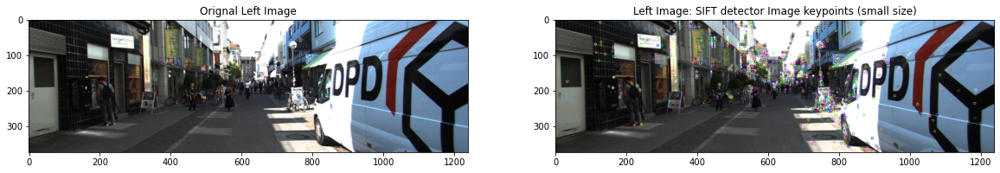

Right Image 3
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 3 ------------------------------------------------------


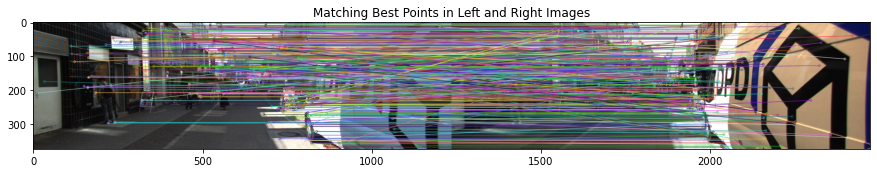

Total Matching Points Between Left and Right Image:  500
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


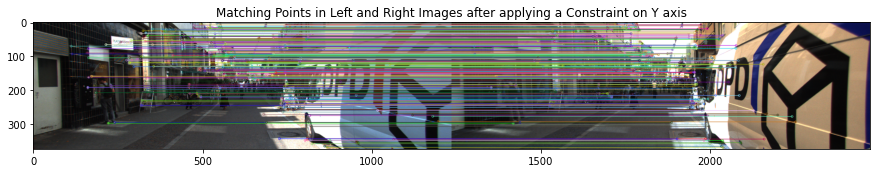

Total features after applying constraint on y-axis of keypoint: 328

 ------------------------------------------------------ Part3 - Image: 3 ------------------------------------------------------


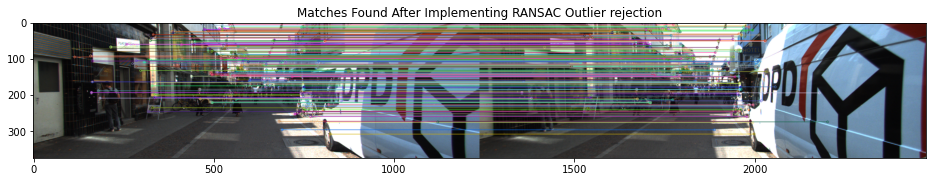


RMSE:  6.410629205744756


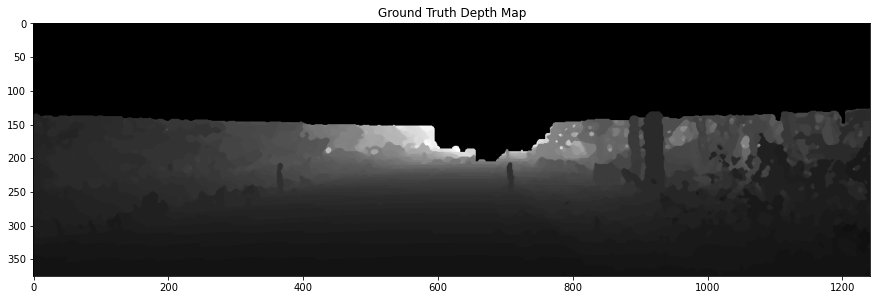


 ------------------------------------------------------ Part1 - Image: 4 ------------------------------------------------------
Left Image 4
Number of Keypoints Detected:  1000


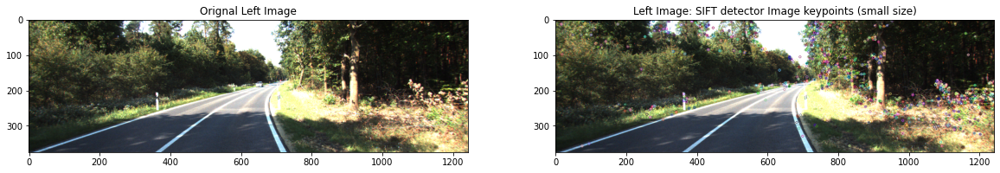

Right Image 4
Number of Keypoints Detected:  1001

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 4 ------------------------------------------------------


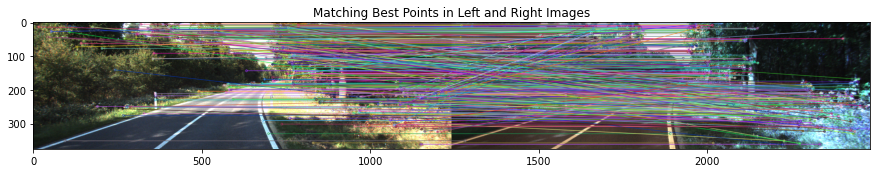

Total Matching Points Between Left and Right Image:  500
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


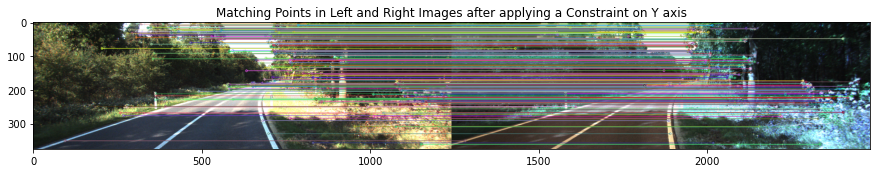

Total features after applying constraint on y-axis of keypoint: 332

 ------------------------------------------------------ Part3 - Image: 4 ------------------------------------------------------


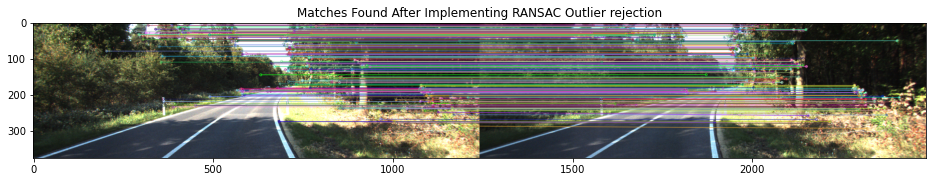


RMSE:  4.35938350404468


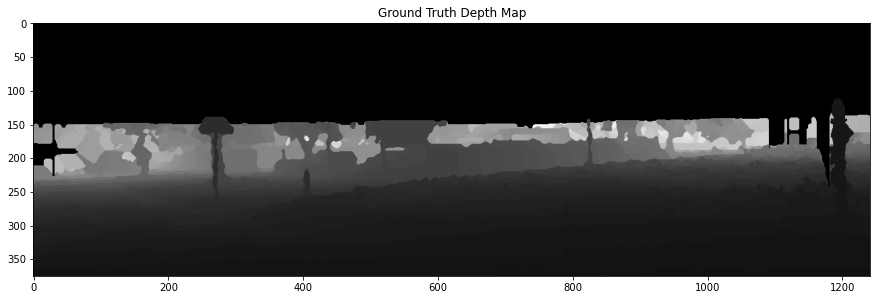


 ------------------------------------------------------ Part1 - Image: 5 ------------------------------------------------------
Left Image 5
Number of Keypoints Detected:  1000


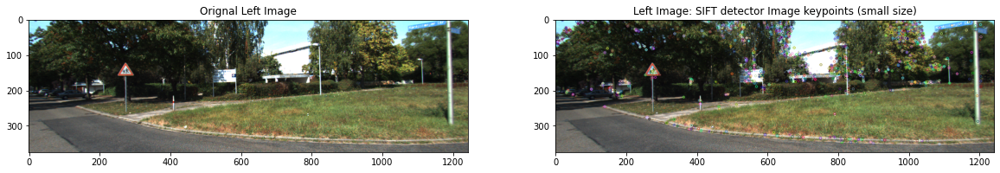

Right Image 5
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 5 ------------------------------------------------------


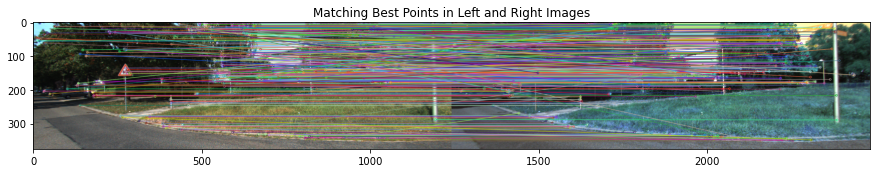

Total Matching Points Between Left and Right Image:  501
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


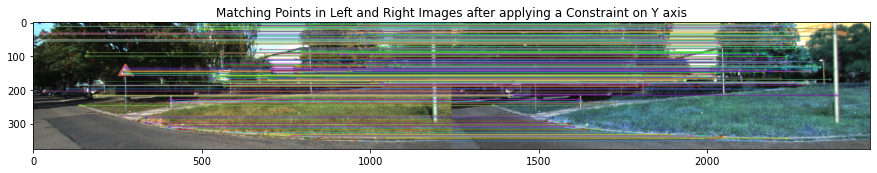

Total features after applying constraint on y-axis of keypoint: 362

 ------------------------------------------------------ Part3 - Image: 5 ------------------------------------------------------


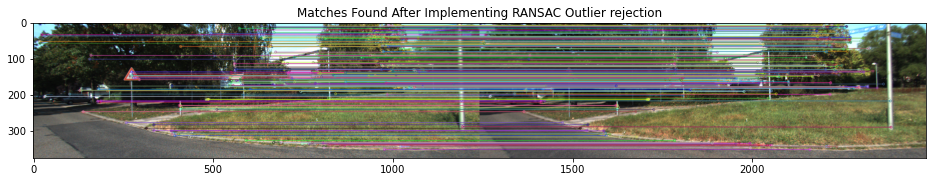


RMSE:  9.695078552244619


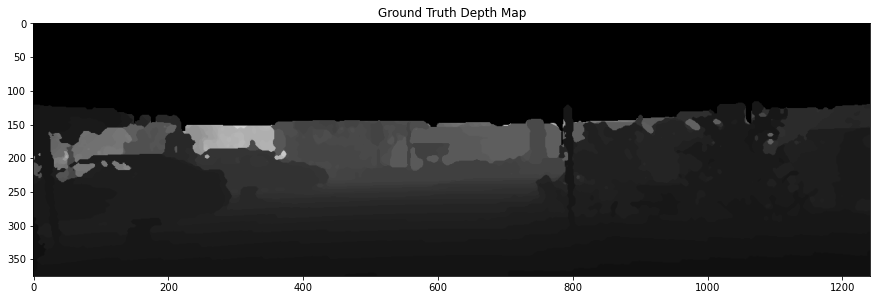


 ------------------------------------------------------ Part1 - Image: 6 ------------------------------------------------------
Left Image 6
Number of Keypoints Detected:  1001


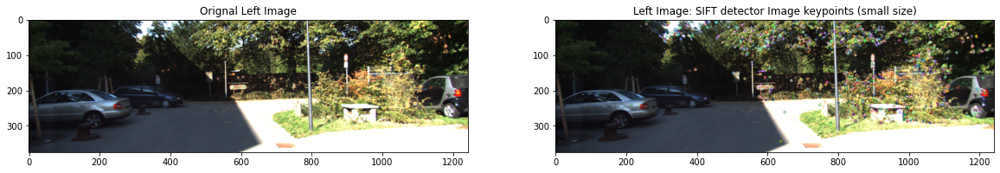

Right Image 6
Number of Keypoints Detected:  1001

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 6 ------------------------------------------------------


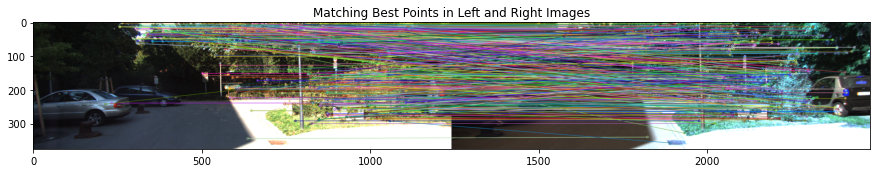

Total Matching Points Between Left and Right Image:  442
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


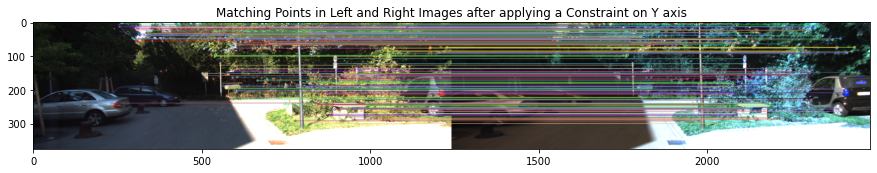

Total features after applying constraint on y-axis of keypoint: 218

 ------------------------------------------------------ Part3 - Image: 6 ------------------------------------------------------


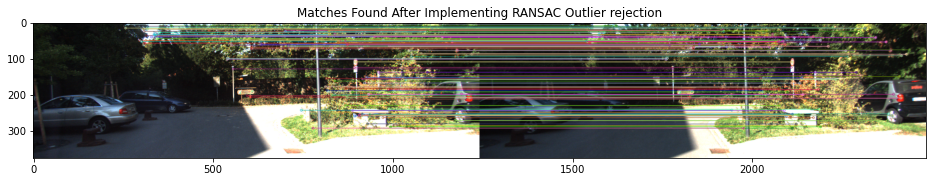


RMSE:  4.581716638523304


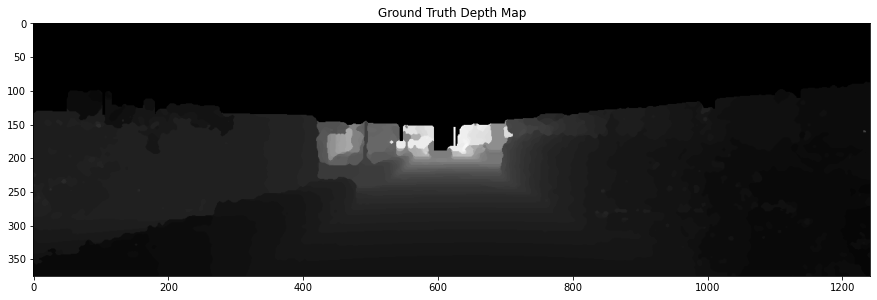


 ------------------------------------------------------ Part1 - Image: 7 ------------------------------------------------------
Left Image 7
Number of Keypoints Detected:  1001


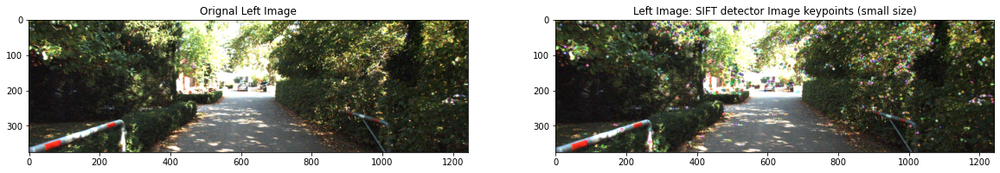

Right Image 7
Number of Keypoints Detected:  1001

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 7 ------------------------------------------------------


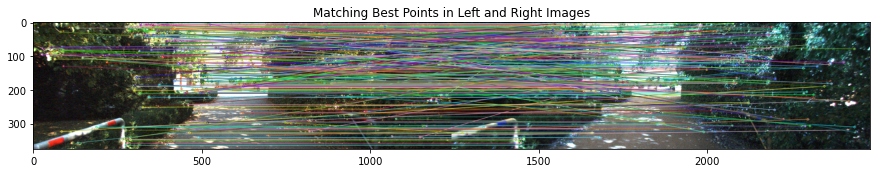

Total Matching Points Between Left and Right Image:  363
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


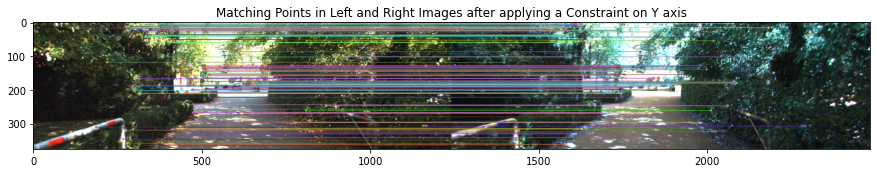

Total features after applying constraint on y-axis of keypoint: 177

 ------------------------------------------------------ Part3 - Image: 7 ------------------------------------------------------


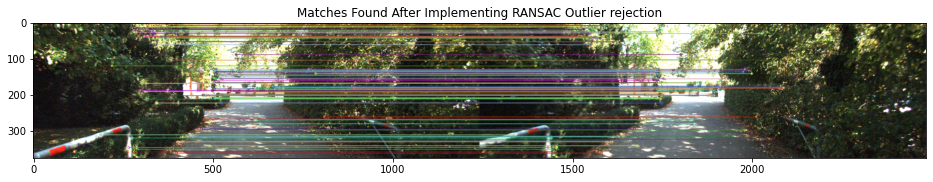


RMSE:  3.839757126767679


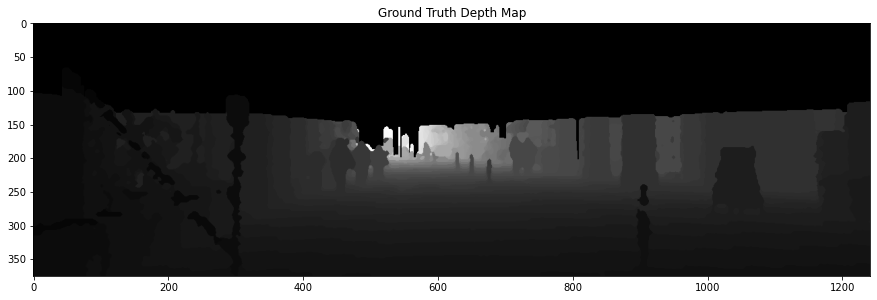


 ------------------------------------------------------ Part1 - Image: 8 ------------------------------------------------------
Left Image 8
Number of Keypoints Detected:  1000


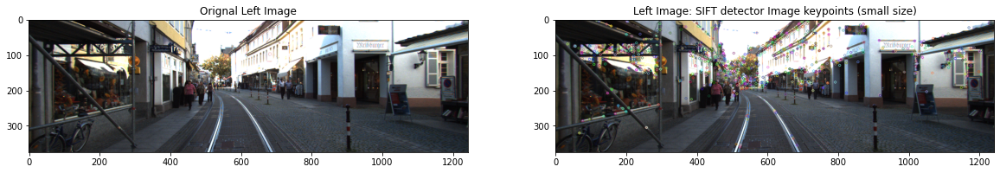

Right Image 8
Number of Keypoints Detected:  1002

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 8 ------------------------------------------------------


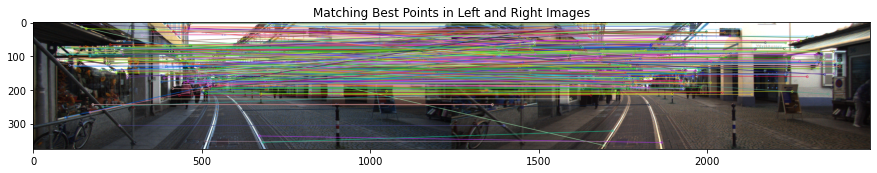

Total Matching Points Between Left and Right Image:  491
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


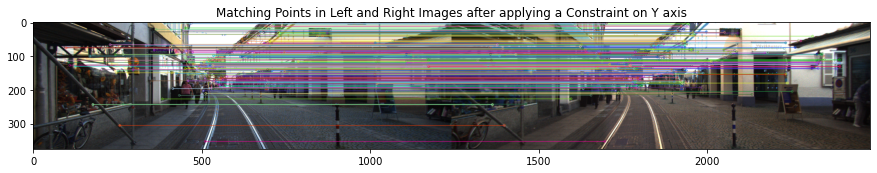

Total features after applying constraint on y-axis of keypoint: 306

 ------------------------------------------------------ Part3 - Image: 8 ------------------------------------------------------


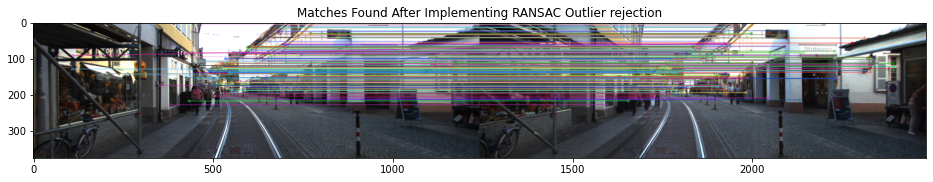


RMSE:  33.862623835805934


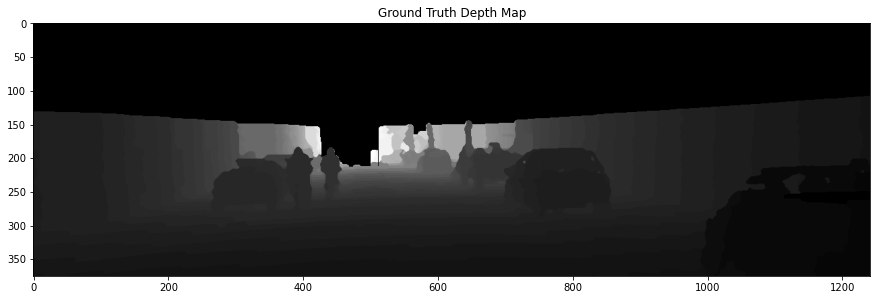


 ------------------------------------------------------ Part1 - Image: 9 ------------------------------------------------------
Left Image 9
Number of Keypoints Detected:  1000


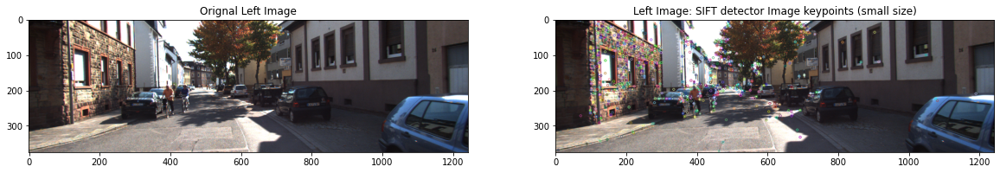

Right Image 9
Number of Keypoints Detected:  1001

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 9 ------------------------------------------------------


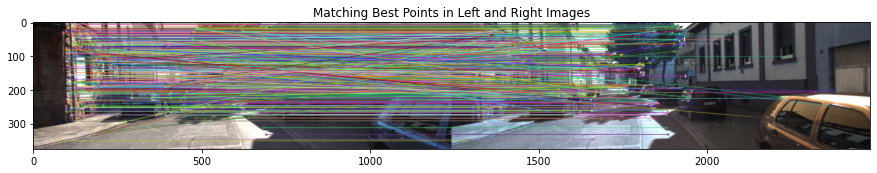

Total Matching Points Between Left and Right Image:  596
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


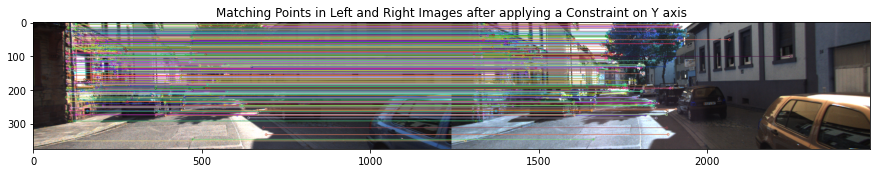

Total features after applying constraint on y-axis of keypoint: 487

 ------------------------------------------------------ Part3 - Image: 9 ------------------------------------------------------


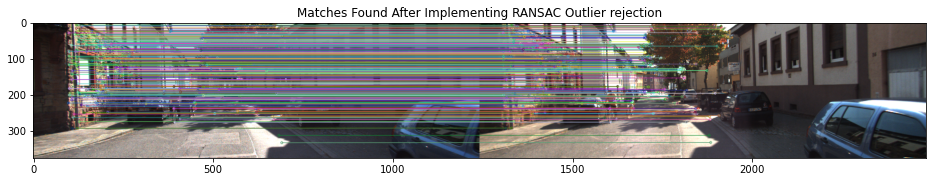


RMSE:  11.413862412861585


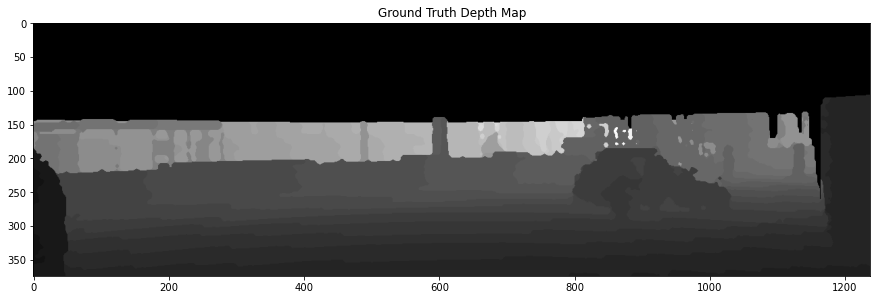


 ------------------------------------------------------ Part1 - Image: 10 ------------------------------------------------------
Left Image 10
Number of Keypoints Detected:  1001


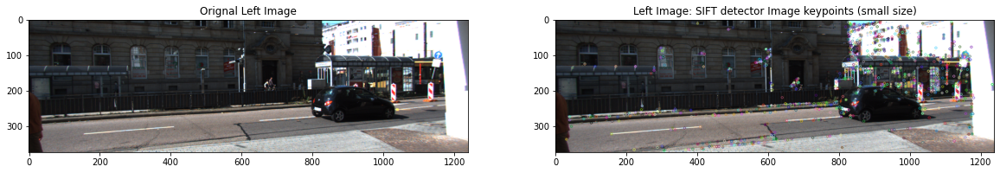

Right Image 10
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 10 ------------------------------------------------------


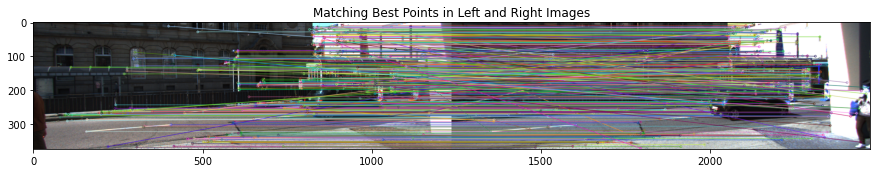

Total Matching Points Between Left and Right Image:  494
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


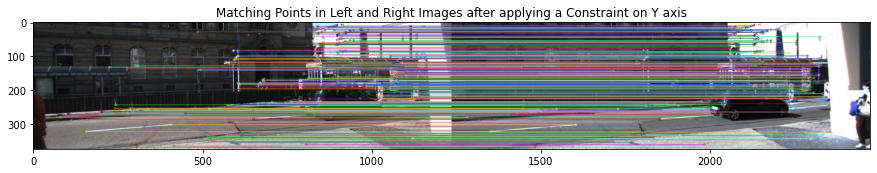

Total features after applying constraint on y-axis of keypoint: 368

 ------------------------------------------------------ Part3 - Image: 10 ------------------------------------------------------


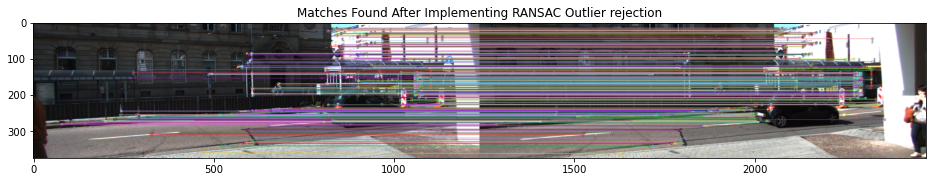


RMSE:  2.4941883696590526
Detector:  sift  Image  1  RMSE:  4.39638137730313
Detector:  sift  Image  2  RMSE:  0.9321201302288871
Detector:  sift  Image  3  RMSE:  6.410629205744756
Detector:  sift  Image  4  RMSE:  4.35938350404468
Detector:  sift  Image  5  RMSE:  9.695078552244619
Detector:  sift  Image  6  RMSE:  4.581716638523304
Detector:  sift  Image  7  RMSE:  3.839757126767679
Detector:  sift  Image  8  RMSE:  33.862623835805934
Detector:  sift  Image  9  RMSE:  11.413862412861585
Detector:  sift  Image  10  RMSE:  2.4941883696590526


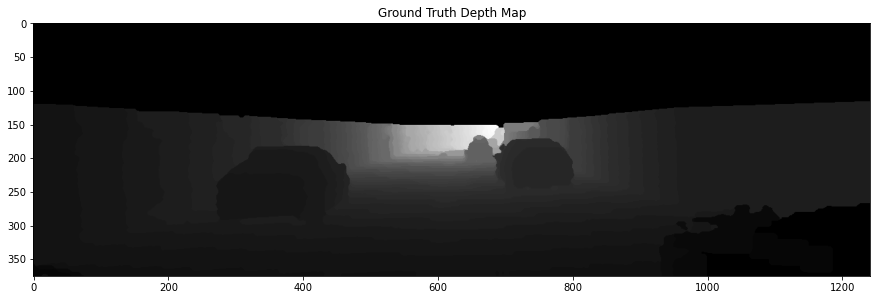


 ------------------------------------------------------ Part1 - Image: 1 ------------------------------------------------------
Left Image 1
Number of Keypoints Detected:  1000


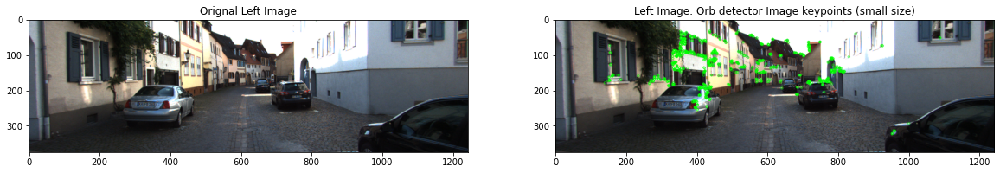

Right Image 1
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 1 ------------------------------------------------------


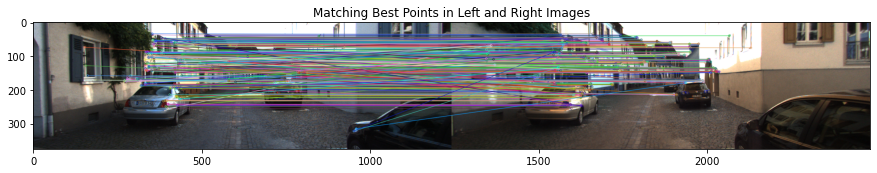

Total Matching Points Between Left and Right Image:  470
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


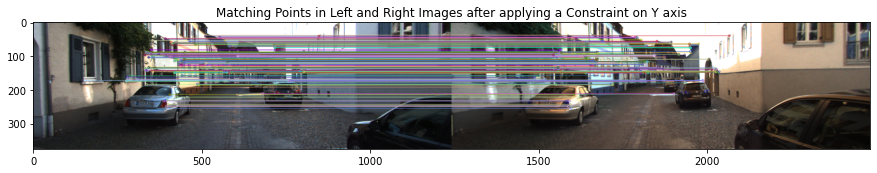

Total features after applying constraint on y-axis of keypoint: 283

 ------------------------------------------------------ Part3 - Image: 1 ------------------------------------------------------


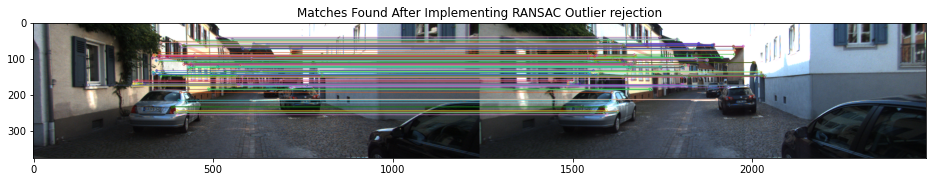


RMSE:  4.88802076023364


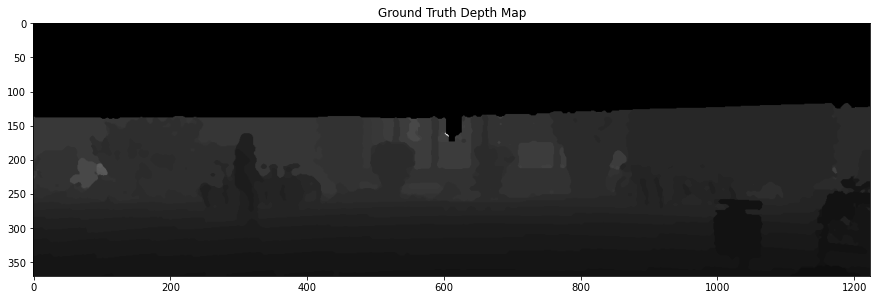


 ------------------------------------------------------ Part1 - Image: 2 ------------------------------------------------------
Left Image 2
Number of Keypoints Detected:  1000


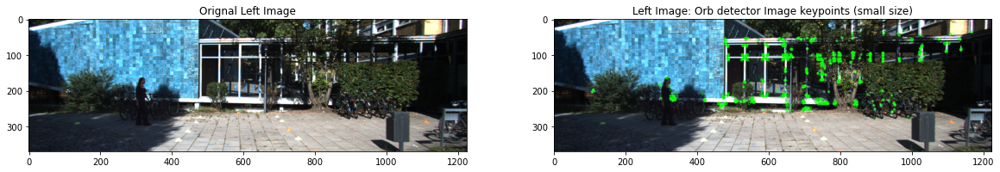

Right Image 2
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 2 ------------------------------------------------------


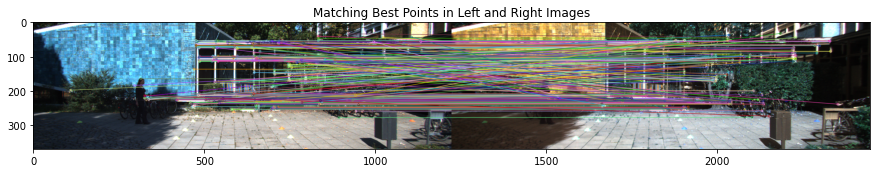

Total Matching Points Between Left and Right Image:  422
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


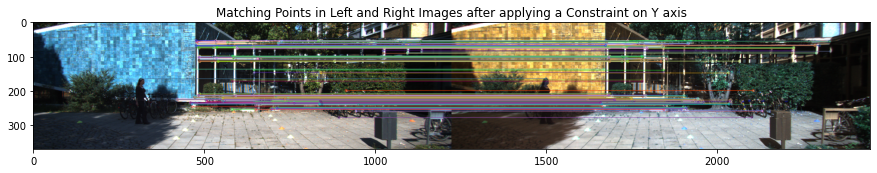

Total features after applying constraint on y-axis of keypoint: 244

 ------------------------------------------------------ Part3 - Image: 2 ------------------------------------------------------


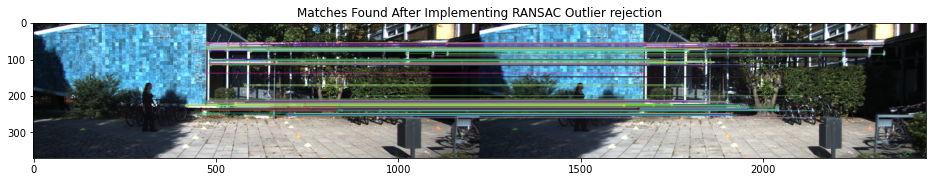


RMSE:  0.9963489652310372


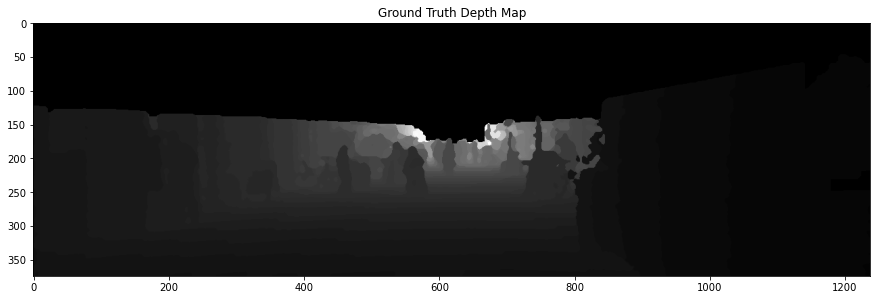


 ------------------------------------------------------ Part1 - Image: 3 ------------------------------------------------------
Left Image 3
Number of Keypoints Detected:  1000


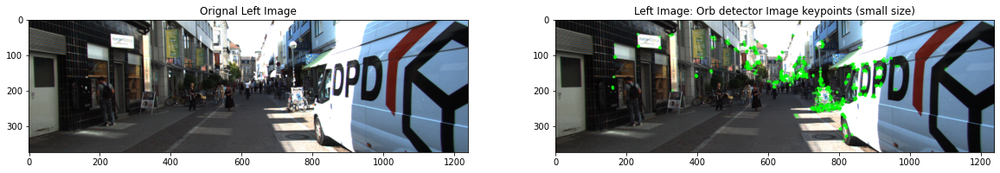

Right Image 3
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 3 ------------------------------------------------------


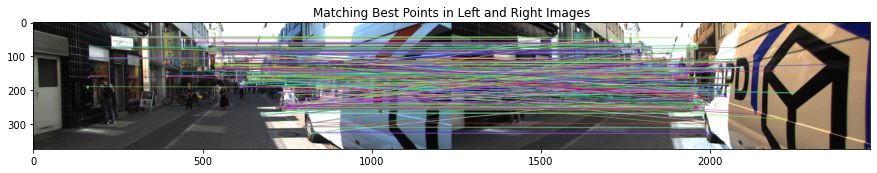

Total Matching Points Between Left and Right Image:  375
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


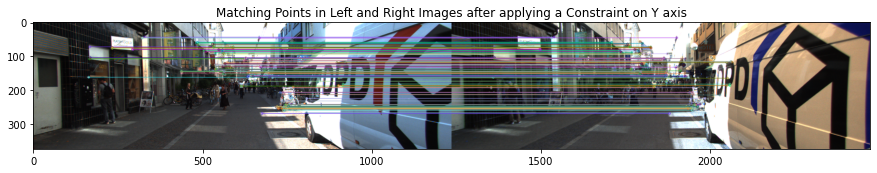

Total features after applying constraint on y-axis of keypoint: 142

 ------------------------------------------------------ Part3 - Image: 3 ------------------------------------------------------


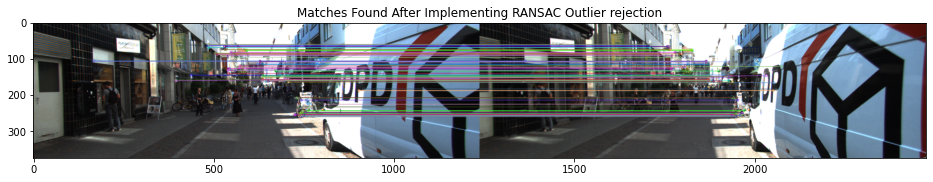


RMSE:  11.923822388446432


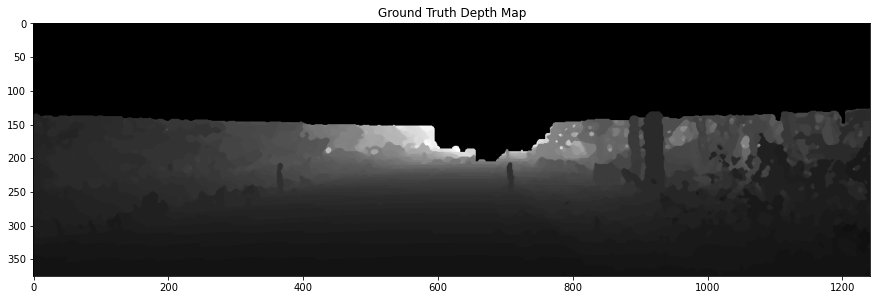


 ------------------------------------------------------ Part1 - Image: 4 ------------------------------------------------------
Left Image 4
Number of Keypoints Detected:  1000


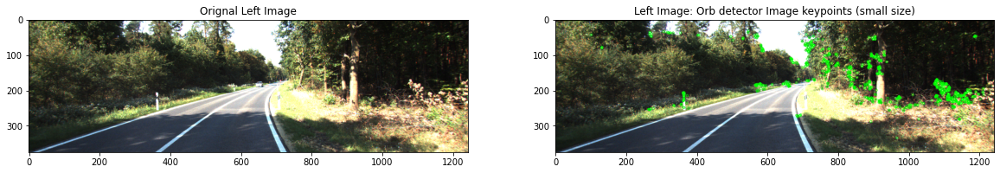

Right Image 4
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 4 ------------------------------------------------------


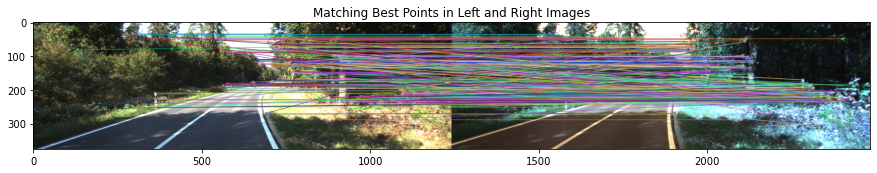

Total Matching Points Between Left and Right Image:  403
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


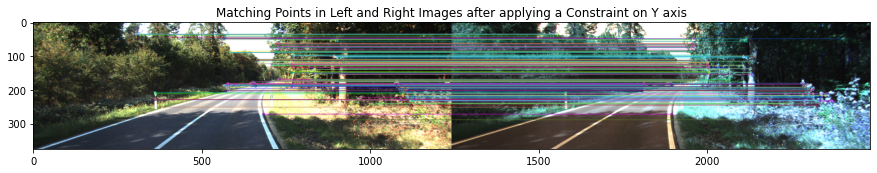

Total features after applying constraint on y-axis of keypoint: 192

 ------------------------------------------------------ Part3 - Image: 4 ------------------------------------------------------


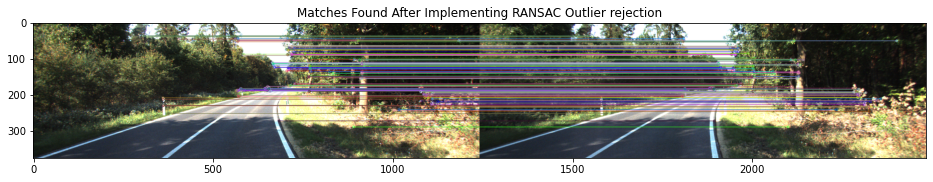


RMSE:  8.309859212616203


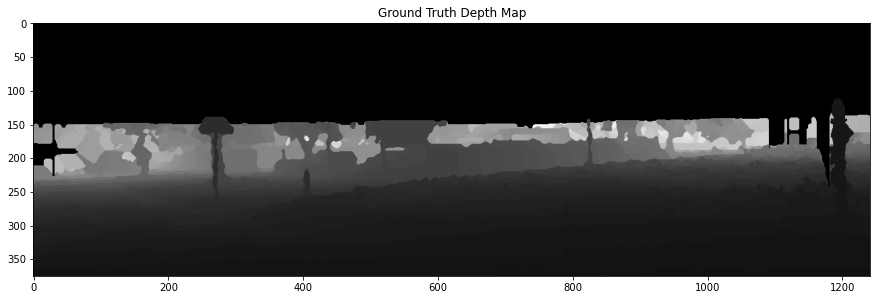


 ------------------------------------------------------ Part1 - Image: 5 ------------------------------------------------------
Left Image 5
Number of Keypoints Detected:  1000


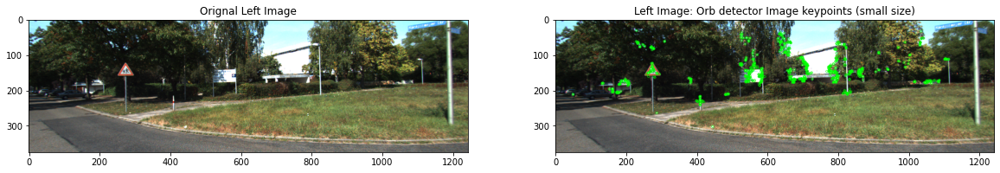

Right Image 5
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 5 ------------------------------------------------------


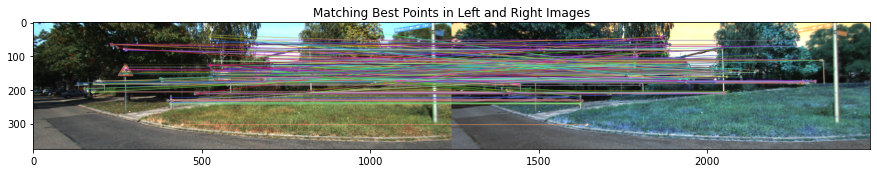

Total Matching Points Between Left and Right Image:  424
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


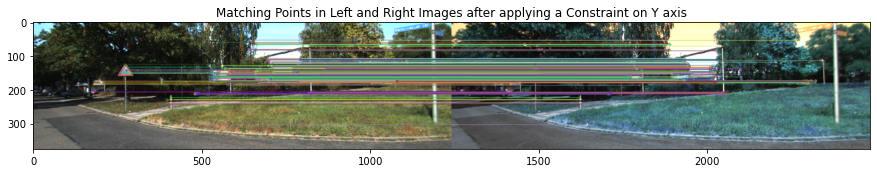

Total features after applying constraint on y-axis of keypoint: 275

 ------------------------------------------------------ Part3 - Image: 5 ------------------------------------------------------


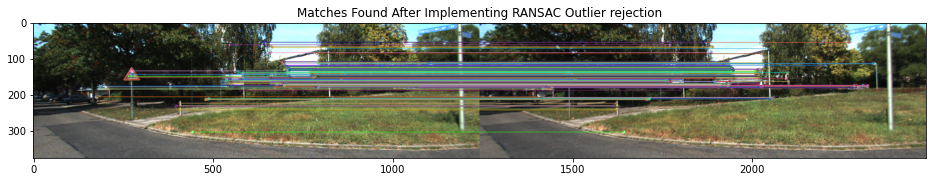


RMSE:  14.106550216725847


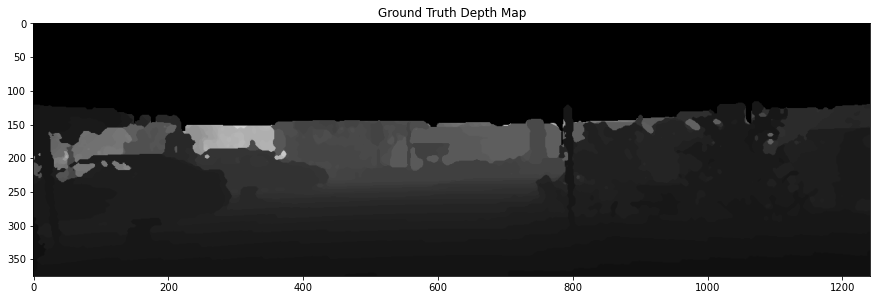


 ------------------------------------------------------ Part1 - Image: 6 ------------------------------------------------------
Left Image 6
Number of Keypoints Detected:  1000


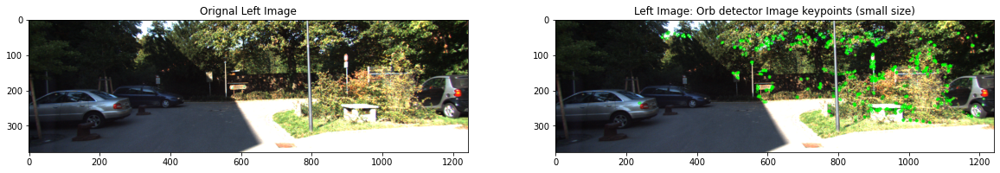

Right Image 6
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 6 ------------------------------------------------------


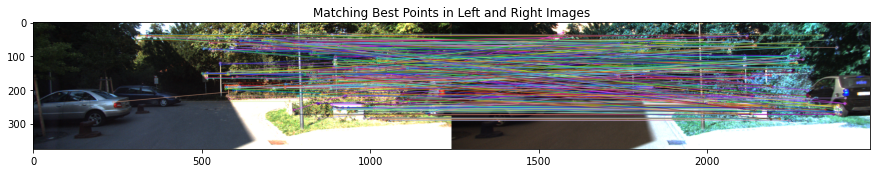

Total Matching Points Between Left and Right Image:  359
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


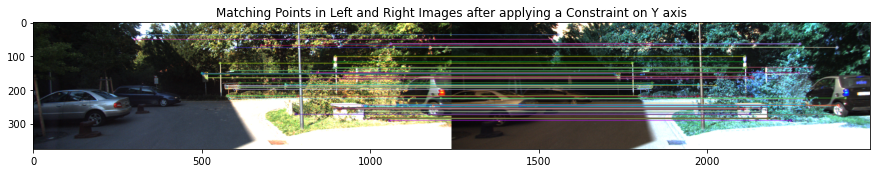

Total features after applying constraint on y-axis of keypoint: 95

 ------------------------------------------------------ Part3 - Image: 6 ------------------------------------------------------


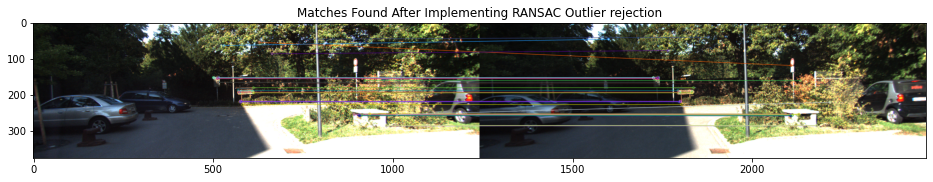


RMSE:  1.0439489828085629


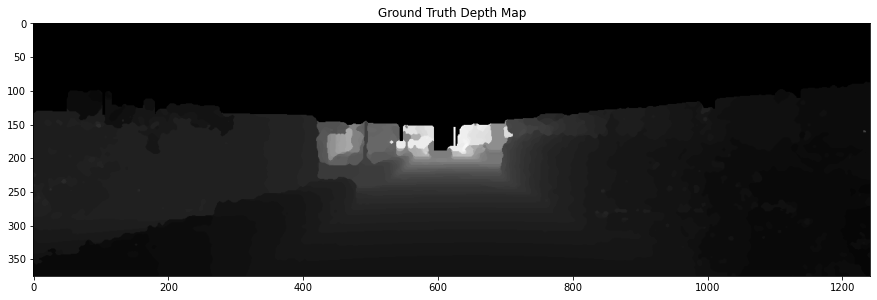


 ------------------------------------------------------ Part1 - Image: 7 ------------------------------------------------------
Left Image 7
Number of Keypoints Detected:  1000


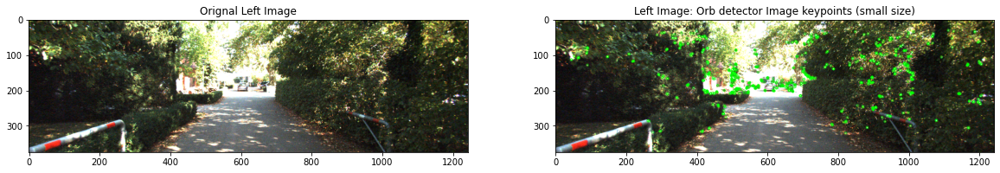

Right Image 7
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 7 ------------------------------------------------------


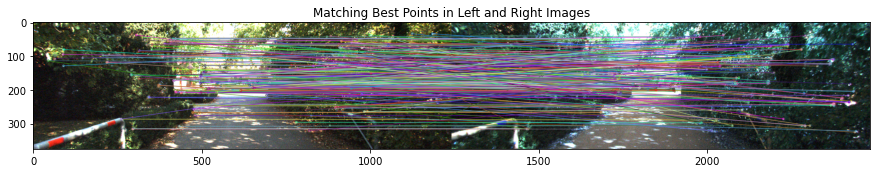

Total Matching Points Between Left and Right Image:  362
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


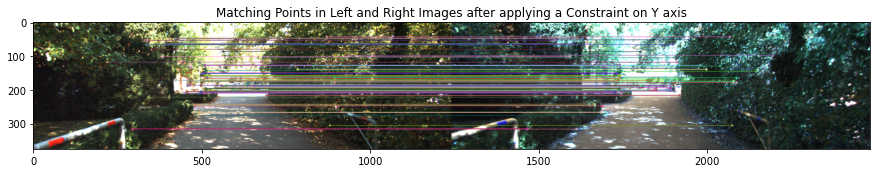

Total features after applying constraint on y-axis of keypoint: 124

 ------------------------------------------------------ Part3 - Image: 7 ------------------------------------------------------


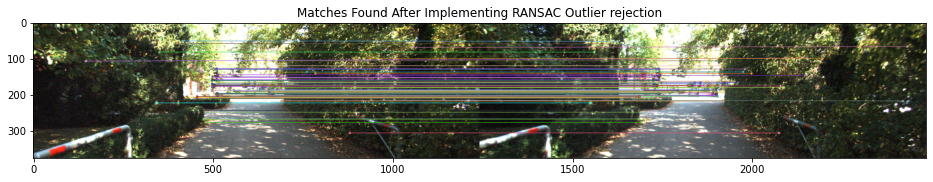


RMSE:  10.071706026825588


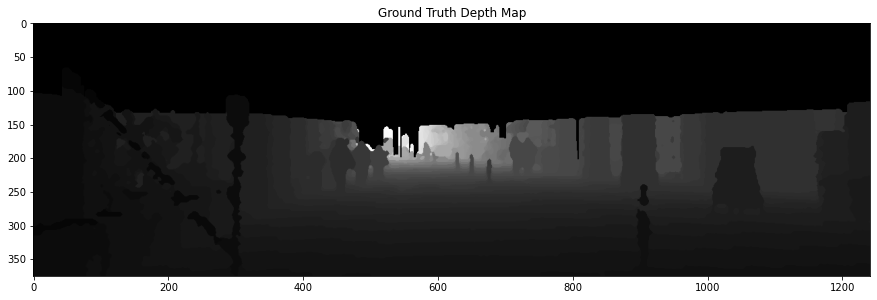


 ------------------------------------------------------ Part1 - Image: 8 ------------------------------------------------------
Left Image 8
Number of Keypoints Detected:  1000


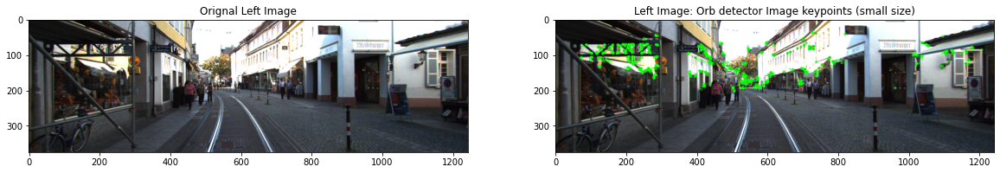

Right Image 8
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 8 ------------------------------------------------------


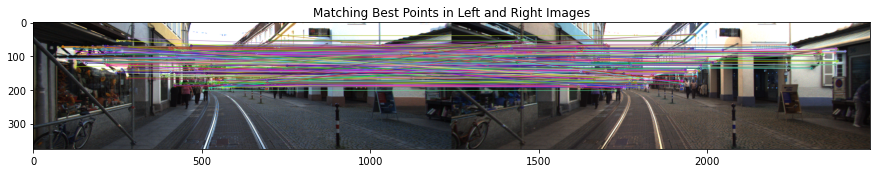

Total Matching Points Between Left and Right Image:  398
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


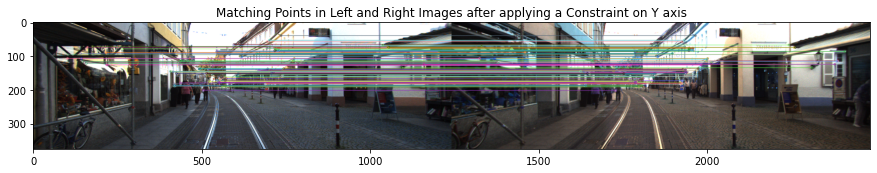

Total features after applying constraint on y-axis of keypoint: 166

 ------------------------------------------------------ Part3 - Image: 8 ------------------------------------------------------


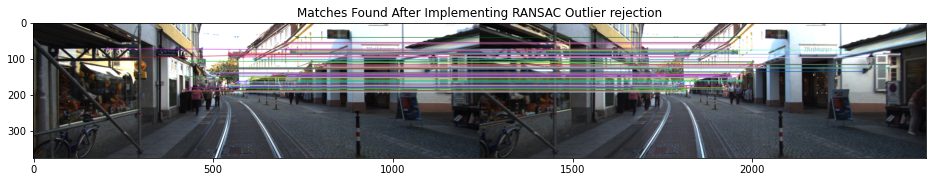


RMSE:  21.88367860047646


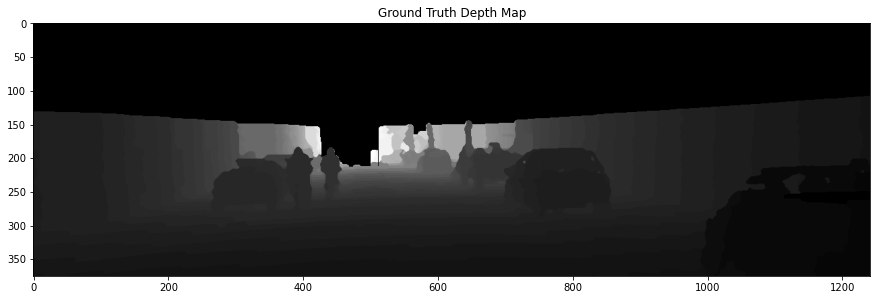


 ------------------------------------------------------ Part1 - Image: 9 ------------------------------------------------------
Left Image 9
Number of Keypoints Detected:  1000


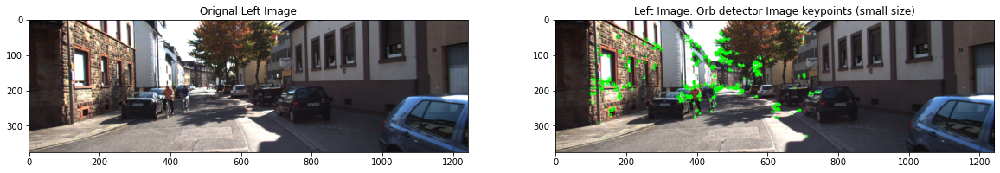

Right Image 9
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 9 ------------------------------------------------------


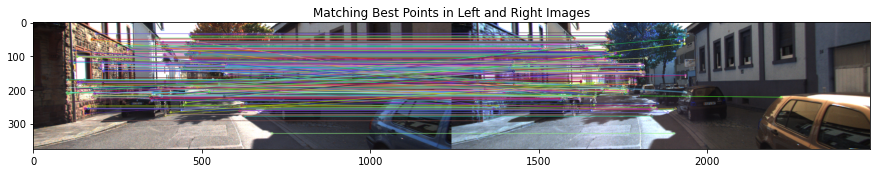

Total Matching Points Between Left and Right Image:  450
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


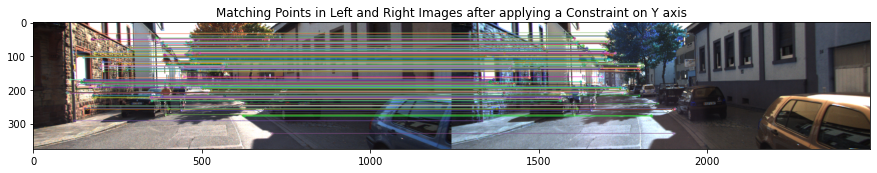

Total features after applying constraint on y-axis of keypoint: 278

 ------------------------------------------------------ Part3 - Image: 9 ------------------------------------------------------


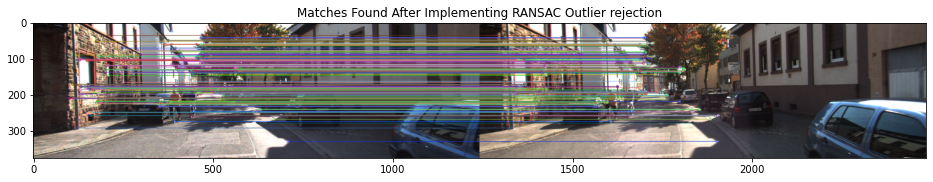


RMSE:  4.760745304454161


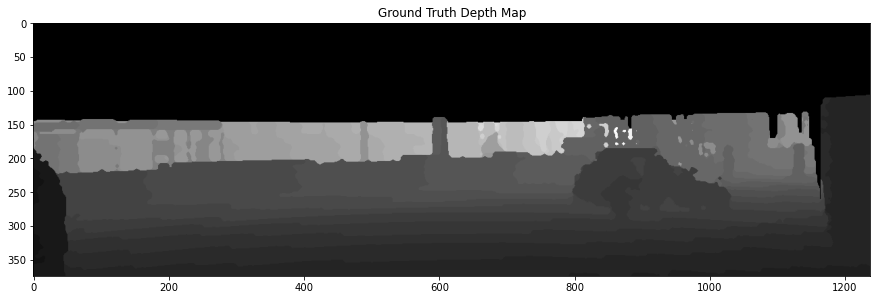


 ------------------------------------------------------ Part1 - Image: 10 ------------------------------------------------------
Left Image 10
Number of Keypoints Detected:  1000


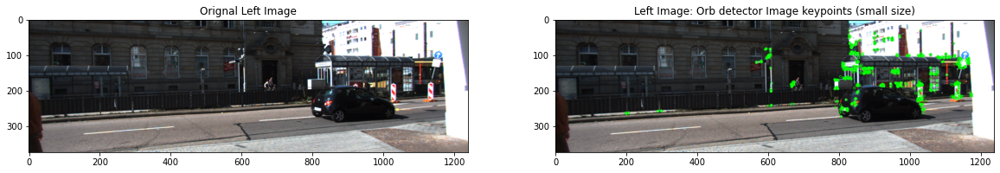

Right Image 10
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 10 ------------------------------------------------------


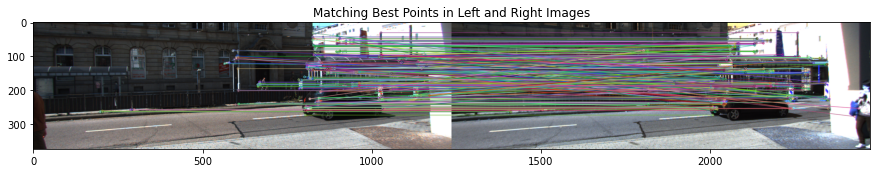

Total Matching Points Between Left and Right Image:  399
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


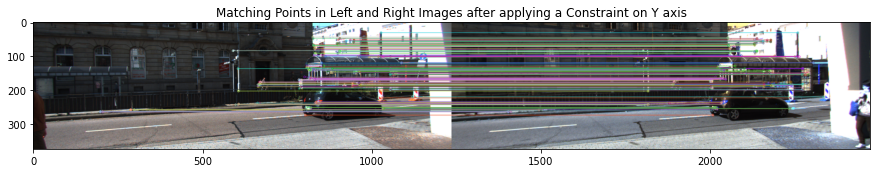

Total features after applying constraint on y-axis of keypoint: 195

 ------------------------------------------------------ Part3 - Image: 10 ------------------------------------------------------


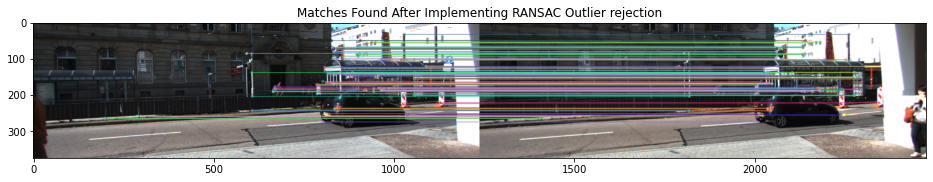


RMSE:  4.891267263329785
Detector:  orb  Image  1  RMSE:  4.88802076023364
Detector:  orb  Image  2  RMSE:  0.9963489652310372
Detector:  orb  Image  3  RMSE:  11.923822388446432
Detector:  orb  Image  4  RMSE:  8.309859212616203
Detector:  orb  Image  5  RMSE:  14.106550216725847
Detector:  orb  Image  6  RMSE:  1.0439489828085629
Detector:  orb  Image  7  RMSE:  10.071706026825588
Detector:  orb  Image  8  RMSE:  21.88367860047646
Detector:  orb  Image  9  RMSE:  4.760745304454161
Detector:  orb  Image  10  RMSE:  4.891267263329785


In [153]:
output_file = open("P3_result.txt", "a")
output_file.truncate(0)

mode = "Training"


detector_list = ["sift","orb"]
for det in detector_list:
    RMSE_list = []

    for i,sample_name in enumerate(sample_list):

        # loading Paths
        left_image_path = left_image_dir +'\\' + sample_name + '.png'
        right_image_path = right_image_dir +'\\' + sample_name + '.png'
        frame_calib_path = calib_dir +'\\' + sample_name + '.txt'

        # Loading Depth Map Path
        if mode == "Training":
            try:
                depth_map_path = gt_depth +'\\' + sample_name + '.png' 
                depth_image = cv.imread(depth_map_path, cv.IMREAD_GRAYSCALE).T

                #print(depth_image.astype(float))
                #print(depth_image.T.shape)

                plt.imshow(depth_image.T, cmap='gray')
                plt.title('Ground Truth Depth Map')
                plt.show()
            except:
                print("depth Image not found")

        img_left = cv.imread(left_image_path, 1)
        img_right = cv.imread(right_image_path, 1)

        
        
        
        #                                             PART 1

        # TODO: Initialize a feature detector using feature_detection function
        print("\n","-"*54,"Part1 - Image: "+str(i+1)+" "+"-"*54)


        # NOTE: feature_detection (Image, Image Title, Visualize Image =YES/NO, Detector (SIFT,FAST,ORB), # of features)
        # Default Visualizatio is YES, Default Detector is SIFT, Default Features are 1000  

        print('Left Image '+str(i+1))
        left_kp, left_des, img_left_rgb, img_left_gray = feature_detection(img_left,"Left Image",detector= det)

        print('Right Image '+str(i+1))
        right_kp, right_des, img_right_rgb, img_right_gray = feature_detection(img_right,"Right Image","no",detector= det)
        
        
        
        
        
        #                                                PART 2
        # TODO: Perform feature matching
        print("\n","-"*54,"Part2 - Image: "+str(i+1)+" "+"-"*54)

        matches, good = feature_matching(left_kp, left_des, img_left, img_left_gray, right_kp, right_des,img_right, img_right_gray)

        '''   frame_calib = read_frame_calib(frame_calib_path)

        stereo_calib = get_stereo_calibration(frame_calib.p2, frame_calib.p3)

        baseline = stereo_calib.baseline
        f = stereo_calib.f
        fB = baseline*f'''


        #initialize arrays
        #left_points = []
        #right_points = []

        #left_points1, right_points1, pixel_u_list1, pixel_v_list1, disparity_list1, depth_list1, X1, Y1 = feature_outlier(matches, 
                                                #left_kp, right_kp, frame_calib_path,  img_left_rgb, img_right_rgb, depth_image)



        
        
        
        #                                                PART 3
        # TODO: Perform outlier rejection
        print("\n","-"*54,"Part3 - Image: "+str(i+1)+" "+"-"*54)



        left_points, right_points, pixel_u_list,pixel_v_list, disparity_list, depth_list, X, Y, RMSE, matches  = feature_outlier(matches,left_kp, right_kp, frame_calib_path, img_left_rgb, img_right_rgb, depth_image,mode,True)

        print("\nRMSE: ",RMSE)
        RMSE_list.append(RMSE)

        '''# Output
        for u, v, disp, depth in zip(pixel_u_list, pixel_v_list, disparity_list, depth_list):
            line = "{} {:.2f} {:.2f} {:.2f} {:.2f}".format(sample_name, u, v, disp, depth)
            output_file.write(line + '\n')'''

        # Draw matches
        #img = cv.drawMatches(img_left, kp_left, img_right, kp_right, matches, None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        #plt.imshow(img)
        #plt.show()

    
    for i in range(len(RMSE_list)):
        print("Detector: ",det," Image ",(i+1)," RMSE: ",RMSE_list[i])
    
output_file.close()

# Working with Test Data

## File Location -Test

In [154]:
## Input
left_image_dir_t = os.path.abspath('.\\test\\left')
#print('Left Image Directory: ',left_image_dir)

right_image_dir_t = os.path.abspath('.\\test\\right')
#print('Right Image Directory: ',right_image_dir)

calib_dir_t = os.path.abspath('.\\test\\calib')
#print('Calib Directory: ',calib_dir)

try:
    gt_depth_t = os.path.abspath('.\\test\\gt_depth_map')
except:
    pass

sample_list_t = ['000011', '000012', '000013', '000014','000015']



## Main Function - Test
## If you have ground truth for the test images. Set the variable mode = "Training" (on line 6) and it will give you RMSE score in the output.


 ------------------------------------------------------ Part1 - Image: 1 ------------------------------------------------------
Left Image 1
Number of Keypoints Detected:  1000


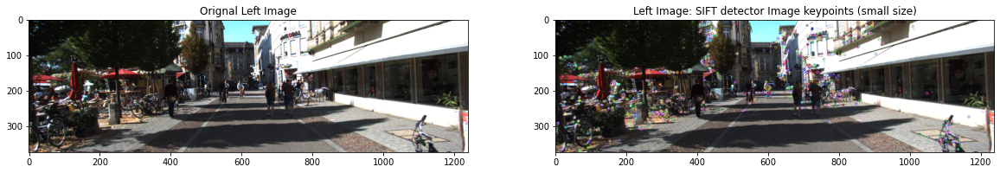

Right Image 1
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 1 ------------------------------------------------------


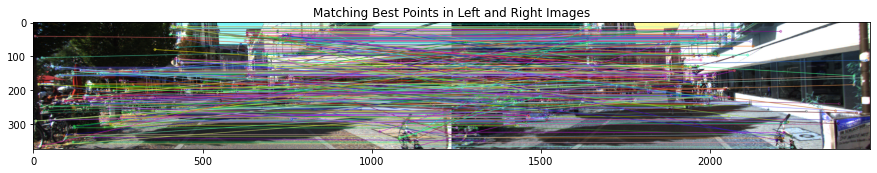

Total Matching Points Between Left and Right Image:  451
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


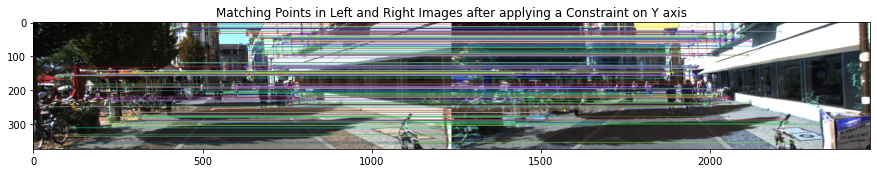

Total features after applying constraint on y-axis of keypoint: 258

 ------------------------------------------------------ Part3 - Image: 1 ------------------------------------------------------


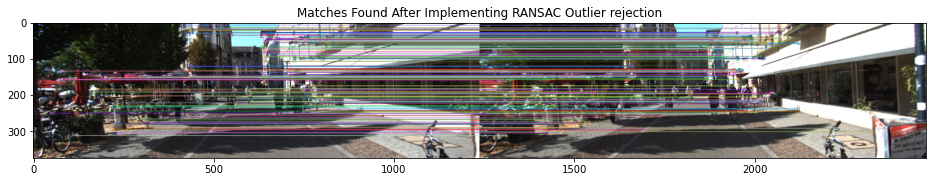

Total features after applying RANSAC outlier rejections: 219

RMSE:  N/A
##################################################################################################################

 ------------------------------------------------------ Part1 - Image: 2 ------------------------------------------------------
Left Image 2
Number of Keypoints Detected:  1000


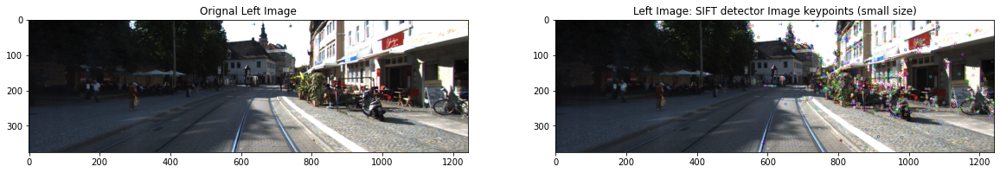

Right Image 2
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 2 ------------------------------------------------------


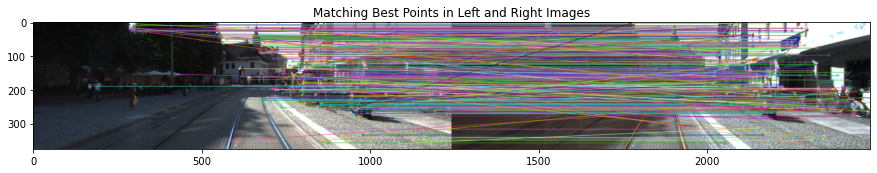

Total Matching Points Between Left and Right Image:  524
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


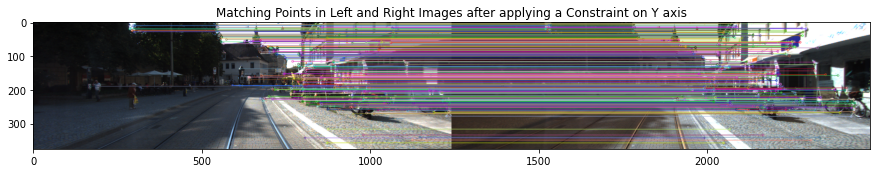

Total features after applying constraint on y-axis of keypoint: 386

 ------------------------------------------------------ Part3 - Image: 2 ------------------------------------------------------


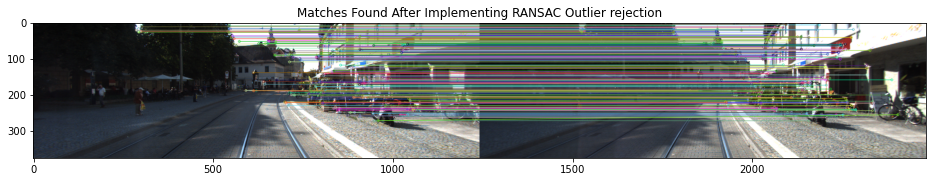

Total features after applying RANSAC outlier rejections: 259

RMSE:  N/A
##################################################################################################################

 ------------------------------------------------------ Part1 - Image: 3 ------------------------------------------------------
Left Image 3
Number of Keypoints Detected:  1001


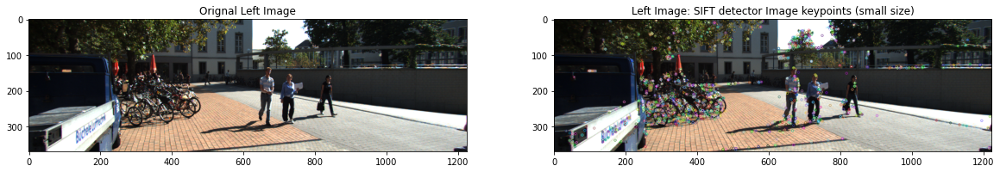

Right Image 3
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 3 ------------------------------------------------------


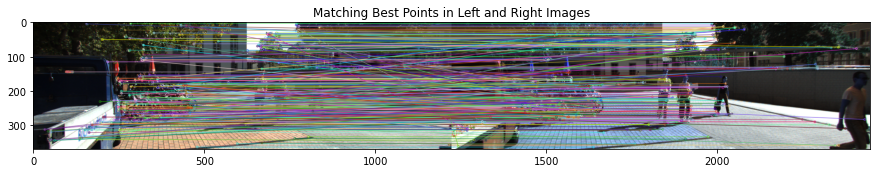

Total Matching Points Between Left and Right Image:  448
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


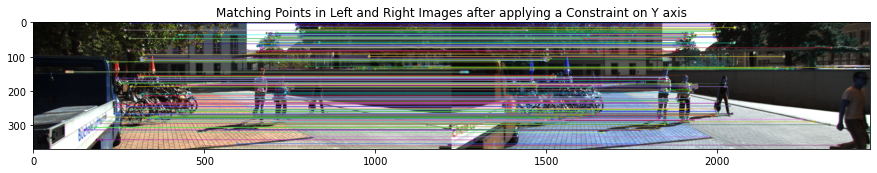

Total features after applying constraint on y-axis of keypoint: 267

 ------------------------------------------------------ Part3 - Image: 3 ------------------------------------------------------


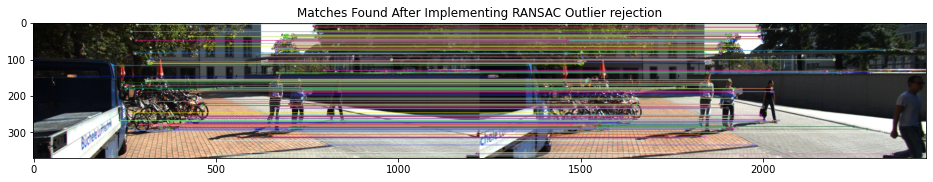

Total features after applying RANSAC outlier rejections: 223

RMSE:  N/A
##################################################################################################################

 ------------------------------------------------------ Part1 - Image: 4 ------------------------------------------------------
Left Image 4
Number of Keypoints Detected:  1000


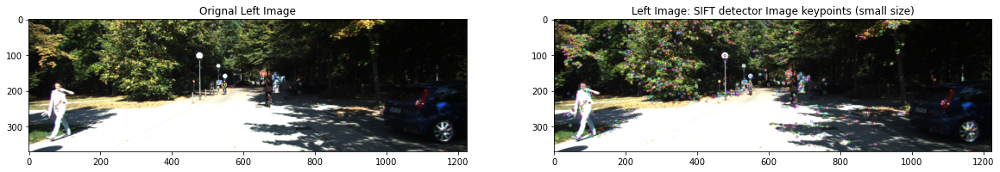

Right Image 4
Number of Keypoints Detected:  1000

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 4 ------------------------------------------------------


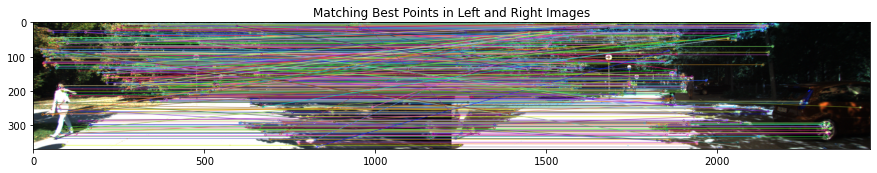

Total Matching Points Between Left and Right Image:  560
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


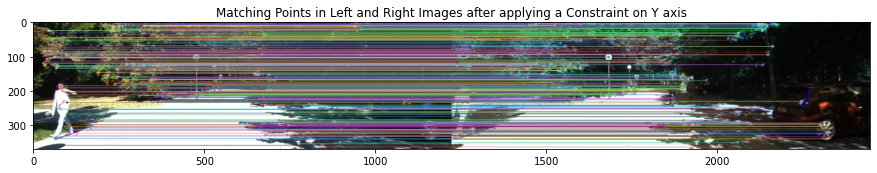

Total features after applying constraint on y-axis of keypoint: 463

 ------------------------------------------------------ Part3 - Image: 4 ------------------------------------------------------


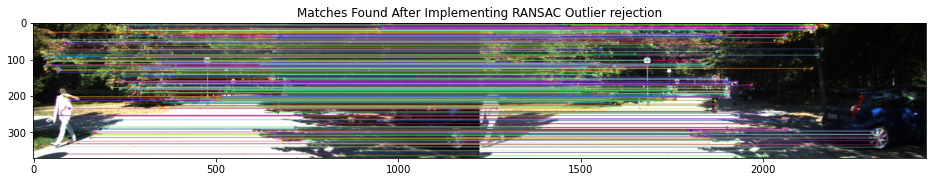

Total features after applying RANSAC outlier rejections: 415

RMSE:  N/A
##################################################################################################################

 ------------------------------------------------------ Part1 - Image: 5 ------------------------------------------------------
Left Image 5
Number of Keypoints Detected:  1000


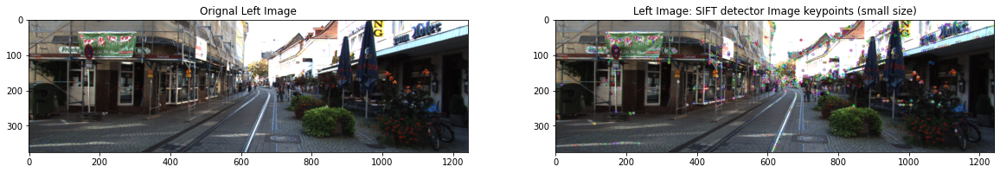

Right Image 5
Number of Keypoints Detected:  1001

Visualization turned off

 ------------------------------------------------------ Part2 - Image: 5 ------------------------------------------------------


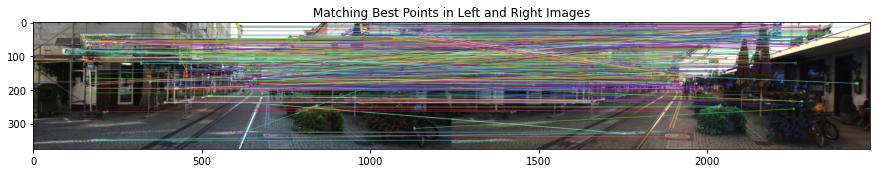

Total Matching Points Between Left and Right Image:  476
						 -------------------------

 Remove Non-Horizontal Lines: Applying Constraint on y axis Y_left Image - Y_Right Image <= 1


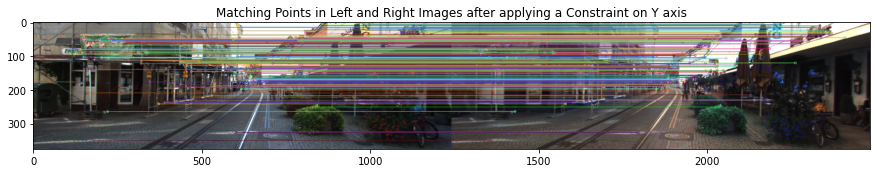

Total features after applying constraint on y-axis of keypoint: 302

 ------------------------------------------------------ Part3 - Image: 5 ------------------------------------------------------


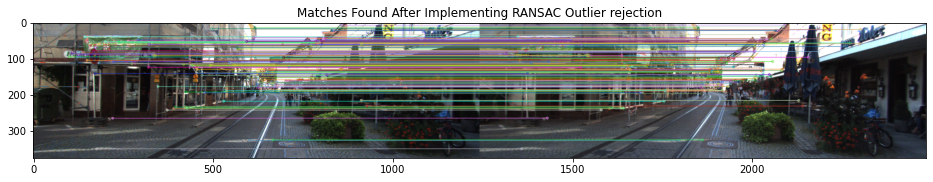

Total features after applying RANSAC outlier rejections: 233

RMSE:  N/A
##################################################################################################################
Detector:  sift  Image  1  RMSE:  N/A
Detector:  sift  Image  2  RMSE:  N/A
Detector:  sift  Image  3  RMSE:  N/A
Detector:  sift  Image  4  RMSE:  N/A
Detector:  sift  Image  5  RMSE:  N/A


In [160]:
## Output
output_file = open("P3_result.txt", "a")
output_file.truncate(0)
RMSE_list = []

mode = "Test"  # CHANGE TO "Training" IF THE GROUND TRUTH ARE AVAILABLE TO GIVE YOU RMSE VALUES

## Main

# Chosing SIFT as out detector:

det = 'sift'
for i,sample_name in enumerate(sample_list_t):

    # loading Paths
    left_image_path = left_image_dir_t +'\\' + sample_name + '.png'
    right_image_path = right_image_dir_t +'\\' + sample_name + '.png'
    frame_calib_path = calib_dir_t +'\\' + sample_name + '.txt'

    # Loading Depth Map Path but this is only for training mode
    if mode == "Training":
        try:
            depth_map_path = gt_depth +'\\' + sample_name + '.png' 
            depth_image = cv.imread(depth_map_path, cv.IMREAD_GRAYSCALE).T

            #print(depth_image.astype(float))
            #print(depth_image.T.shape)
            
            
            #Display Depth map Image
            plt.imshow(depth_image.T, cmap='gray')
            plt.title('Ground Truth Depth Map')
            plt.show()
            
        except:
            # if depth map image not found
            Print("depth Image not found")

    img_left = cv.imread(left_image_path, 1)
    img_right = cv.imread(right_image_path, 1)


    
    ################################################################################################################
    #                                             PART 1
    # TODO: Initialize a feature detector using feature_detection function
    
    print("\n","-"*54,"Part1 - Image: "+str(i+1)+" "+"-"*54)


    # NOTE: feature_detection (Image, Image Title, Visualize Image =YES/NO, Detector (SIFT,FAST,ORB), # of features)
    # Default Visualizatio is YES, Default Detector is SIFT, Default Features are 1000  

    print('Left Image '+str(i+1))
    left_kp, left_des, img_left_rgb, img_left_gray = feature_detection(img_left,"Left Image",detector= det)

    print('Right Image '+str(i+1))
    right_kp, right_des, img_right_rgb, img_right_gray = feature_detection(img_right,"Right Image","no",detector= det)


    ################################################################################################################

    
    
    
    
    ################################################################################################################
    #                                                PART 2
    # TODO: Perform feature matching
    print("\n","-"*54,"Part2 - Image: "+str(i+1)+" "+"-"*54)

    matches, good = feature_matching(left_kp, left_des, img_left, img_left_gray, right_kp, right_des,img_right, img_right_gray)
    ################################################################################################################


    
    

    ################################################################################################################
    #                                                PART 3
    # TODO: Perform outlier rejection
    print("\n","-"*54,"Part3 - Image: "+str(i+1)+" "+"-"*54)
    


    left_points, right_points, pixel_u_list,pixel_v_list, disparity_list, depth_list, X, Y, RMSE, matches  = feature_outlier(matches,left_kp, right_kp, frame_calib_path, img_left_rgb, img_right_rgb, depth_image,mode,True)

    print("\nRMSE: ",RMSE)
    RMSE_list.append(RMSE)
    ################################################################################################################
    
    
    
    
    
    
    ################################################################################################################
    #                                               Output
    
    for u, v, disp, depth in zip(pixel_u_list, pixel_v_list, disparity_list, depth_list):
        line = "{} {:.2f} {:.2f} {:.2f} {:.2f}".format(sample_name, int(u), int(v), disp, depth)
        output_file.write(line + '\n')
        
    ################################################################################################################
    print('#'*114)

    # Draw matches
    #img = cv.drawMatches(img_left, kp_left, img_right, kp_right, matches, None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    #plt.imshow(img)
    #plt.show()
    
for i in range(len(RMSE_list)):
        print("Detector: ",det," Image ",(i+1)," RMSE: ",RMSE_list[i])
        
output_file.close()